# Sprawozdanie - MOwNiT - laboratorium 4., zadanie 1.

#### Autor: Jakub Psarski

## Aproksymacja TSP z wykorzystaniem symulowanego wyżarzania

Wygeneruj chmurę n losowych punktów w 2D, a następnie zastosuj algorytm symulowanego wyżarzania do przybliżonego rozwiązania problemu komiwojażera dla tych punktów.
- Przedstaw wizualizację otrzymanego rozwiązania dla 3 różnych wartości n oraz 3 różnych układów punktów w 2D (rozkład jednostajny, rozkład normalny z czterema różnymi grupami parametrów, dziewięć odseparowanych grup punktów).
- Zbadaj wpływ sposobu generacji sąsiedniego stanu (consecutive swap vs. arbitrary swap) oraz funkcji zmiany temperatury na zbieżność procesu optymalizacji.
- Przedstaw wizualizację działania procedury minimalizującej funkcję celu.

### 1. Importowanie potrzebnych bibliotek

In [5]:
import copy
import math
import random
import time

import matplotlib.pyplot as plt
import numpy as np
from IPython.display import HTML, display
from matplotlib import animation, rcParams

rcParams['animation.embed_limit'] = 200

### 2. Implementacja algorytmu symulowanego wyżarzania dla TSP

In [6]:
def simulated_annealing(
        points, temperature=100, temp_function=lambda x, _: x*0.995, threshold=1e-2, swap_type="arbitrary"
    ):
    """Solve TSP using simulated annealing."""
    point_amount = len(points)
    dist_matrix = distance_matrix(points)

    current_path = list(range(point_amount))
    random.shuffle(current_path)
    current_length = path_length(current_path, dist_matrix)

    initial_path = copy.deepcopy(current_path)
    initial_length = current_length

    best_path = copy.deepcopy(current_path)
    best_length = current_length
    found_time = t_0 = time.perf_counter()

    lengths = [(0, initial_length)]
    temps = [(0, temperature)]
    paths = [copy.deepcopy(initial_path)]

    while temperature > threshold:
        for _ in range(100):
            match swap_type:
                case "consecutive":
                    i = random.randint(0, point_amount - 2)
                    j = i + 1
                case "arbitrary":
                    i, j = random.sample(range(point_amount), 2)

            current_path[i], current_path[j] = current_path[j], current_path[i]
            new_length = path_length(current_path, dist_matrix)

            if new_length < current_length or random.random() < math.exp((current_length - new_length) / temperature):
                current_length = new_length

                if new_length < best_length:
                    best_path = copy.deepcopy(current_path)
                    best_length = new_length
                    found_time = time.perf_counter() - t_0

            else:
                current_path[i], current_path[j] = current_path[j], current_path[i]

            paths.append(copy.deepcopy(current_path))

            lengths.append((time.perf_counter() - t_0, current_length))

        timestamp = time.perf_counter() - t_0
        temperature = temp_function(temperature, timestamp)
        temps.append((timestamp, temperature))

    return best_path, best_length, found_time, initial_path, initial_length, lengths, temps, paths


### 3. Funkcje pomocnicze

- `generate_points()` - generowanie chmury punktów zgodnie z podanymi parametrami

In [7]:
def generate_points(n, distribution="uniform"):
    """Generate n random points in 2D space with a given distribution."""
    match distribution:
        case "uniform":
            return np.random.rand(n, 2) * 100
        case "normal":
            centers = [(25, 25), (25, 75), (75, 25), (75, 75)]
            points = []
            for _ in range(n):
                center = random.choice(centers)
                points.append(np.random.normal(loc=center, scale=5, size=(1, 2))[0])
            return np.array(points)
        case "clusters":
            clusters = [(10, 10), (90, 90), (10, 90), (90, 10), (50, 50), (25, 75), (75, 25), (25, 25), (75, 75)]
            points = []
            for _ in range(n):
                cluster = random.choice(clusters)
                points.append(np.random.normal(loc=cluster, scale=2, size=(1, 2))[0])
            return np.array(points)

- `distance_matrix()` - generowanie macierzy zawierającej odległości między każdą parą punktów

In [8]:
def distance_matrix(points):
    """Compute the distance matrix for given points."""
    point_amount = len(points)
    dist_matrix = np.zeros((point_amount, point_amount))
    for i in range(point_amount):
        for j in range(point_amount):
            dist_matrix[i, j] = np.linalg.norm(points[i] - points[j])
    return dist_matrix

- `path_length()` - obliczanie długości danej drogi na podstawie macierzy odległości (funkcja kosztu)

In [9]:
def path_length(path, dist_matrix):
    """Calculate the total length of a given path."""
    return sum(dist_matrix[path[i], path[i + 1]] for i in range(len(path) - 1)) + dist_matrix[path[-1], path[0]]

- `plot_path()`, `plot_length()`, `plot_temperature()`, `plot_results()` - wizualizacja wyników oraz parametrów

In [10]:
def plot_path(ax, points, path, title):
    """Plot the given TSP path."""
    ordered_points = np.array([points[i] for i in path] + [points[path[0]]])
    ax.set_title(title)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.plot(ordered_points[:, 0], ordered_points[:, 1], 'bo-')
    ax.scatter(points[:, 0], points[:, 1], c='red')


def plot_length(ax, lengths, title):
    """Plot the path lengths over iterations."""
    x_values, y_values = zip(*lengths)
    ax.plot(x_values, y_values, color='green', lw=0.5)
    ax.set_title(title)
    ax.set_xlabel("Time [s]")
    ax.set_ylabel("Path length")


def plot_temperature(ax, temps, title):
    """Plot the temperature over iterations."""
    x_values, y_values = zip(*temps)
    ax.plot(x_values, y_values, color='red', lw=1)
    ax.set_title(title)
    ax.set_xlabel("Time [s]")
    ax.set_ylabel("Temperature")


def plot_results(
        points, best_path, best_length, found_time, initial_path, initial_length, lengths, temps, n, dist, swap_type
    ):
    """Plot the results of the TSP simulation."""
    fig, axs = plt.subplots(2, 2, figsize=(12, 8))
    fig.suptitle(f"TSP solution for n={n}, distribution: {dist}, swap type: {swap_type}", fontsize=16)

    plot_path(axs[0, 0], points, initial_path, title=f"Initial path: length = {initial_length:.2f}")
    plot_path(axs[0, 1], points, best_path,
              title=f"After annealing: length = {best_length:.2f}, found in {found_time:.2f}s")
    plot_length(axs[1, 0], lengths, title="Path length over time")
    plot_temperature(axs[1, 1], temps, title="Temperature over time")

    plt.show()

- `animate()` - animacja procesu wyżarzania na grafie

In [11]:
def animate(paths, points, best, pos, framerate=30):
    """Create an animation of the TSP solution."""
    best_path = None
    best_length = float('inf')

    def update(frame):
        nonlocal best_path, best_length

        dist_matrix = distance_matrix(points)
        current_length = path_length(frame, dist_matrix)

        if current_length < best_length:
            best_length = current_length
            best_path = copy.deepcopy(frame)

        ax.clear()
        ax.set_title(f"Current length: {current_length:.2f}, Best length: {best_length:.2f}")
        ax.set_xticks([])
        ax.set_yticks([])

        if best_path:
            short_x = [points[x][0] for x in best_path] + [points[best_path[0]][0]]
            short_y = [points[x][1] for x in best_path] + [points[best_path[0]][1]]
            ax.plot(short_x, short_y, color='green', linewidth=5, alpha=0.5, label="Best path")

        x_values = [points[x][0] for x in frame] + [points[frame[0]][0]]
        y_values = [points[x][1] for x in frame] + [points[frame[0]][1]]

        ax.scatter(x_values, y_values, color='red')
        ax.plot(x_values, y_values, color='blue', linewidth=0.5, label="Current path")
        ax.legend()

    fig, ax = plt.subplots(figsize=(8, 8))
    step = len(paths) // 200
    fr = paths[::step]
    fr[int(pos * 200)] = copy.deepcopy(best)    # to make sure the best path is included in the animation sample

    anim = animation.FuncAnimation(
        fig, update, frames=fr, interval=1000//framerate, repeat=False
    )

    plt.close(fig)

    return HTML(anim.to_html5_video())

### 4. Wyniki, czasy działania, wizualizacja

#### 4.1. Porównanie sposobów generacji sąsiedniego stanu, animacje

---------- n = 20 ----------

Distribution: uniform, swap type: arbitrary
Initial path length: 1187.18
Best path length: 354.15, found in 0.91s
Total elapsed time: 2.87s


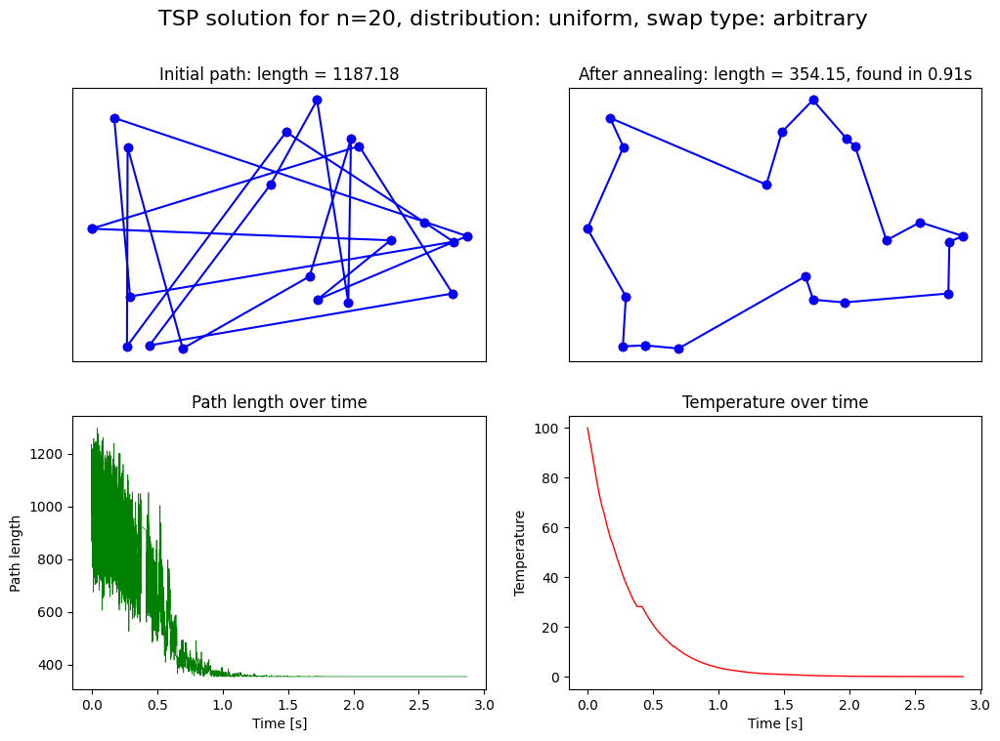

Distribution: uniform, swap type: consecutive
Initial path length: 1107.77
Best path length: 438.19, found in 0.51s
Total elapsed time: 2.63s


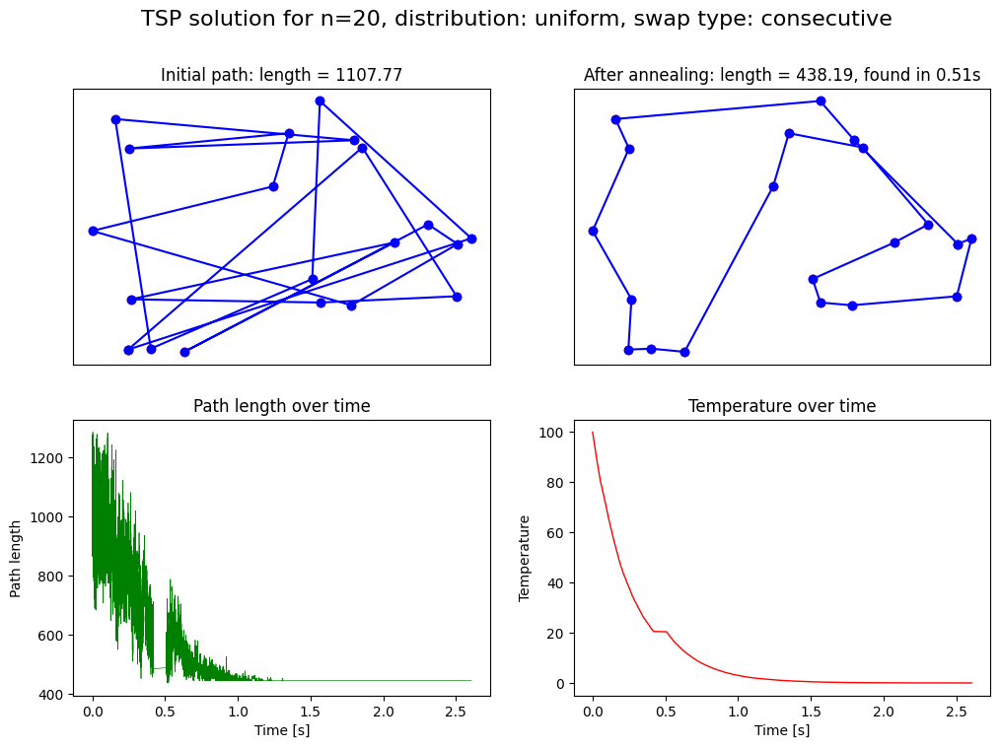

Shortest path comparison for different swap types:
arbitrary: 354.15
consecutive: 438.19

--------------------

Distribution: normal, swap type: arbitrary
Initial path length: 993.92
Best path length: 258.33, found in 1.08s
Total elapsed time: 2.78s


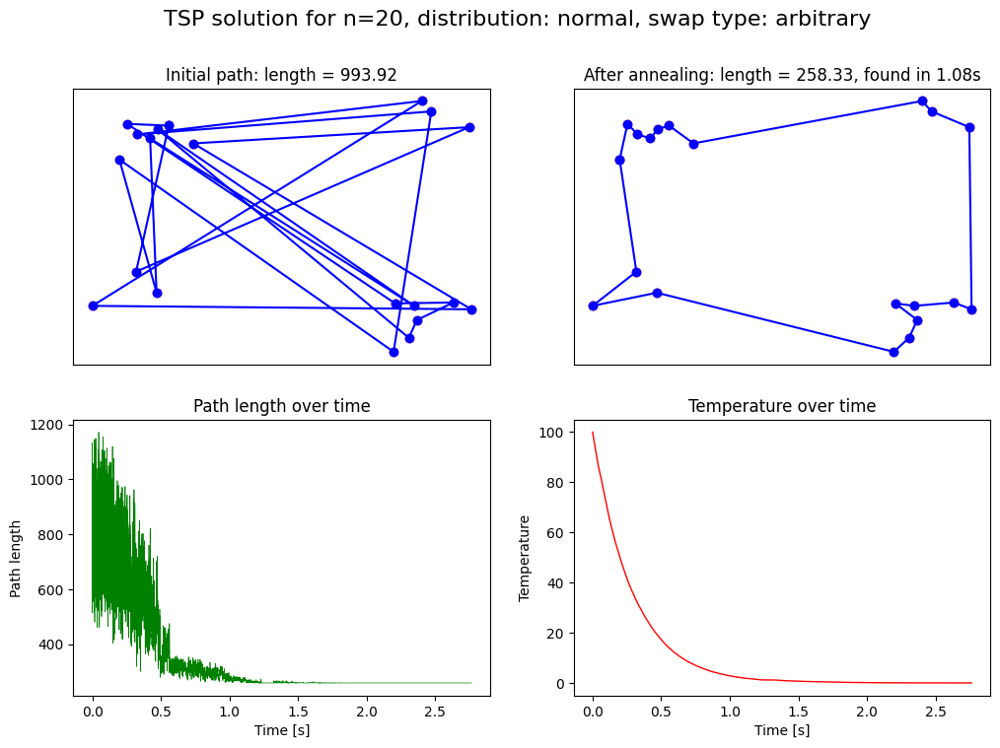

Distribution: normal, swap type: consecutive
Initial path length: 904.90
Best path length: 402.56, found in 0.39s
Total elapsed time: 2.47s


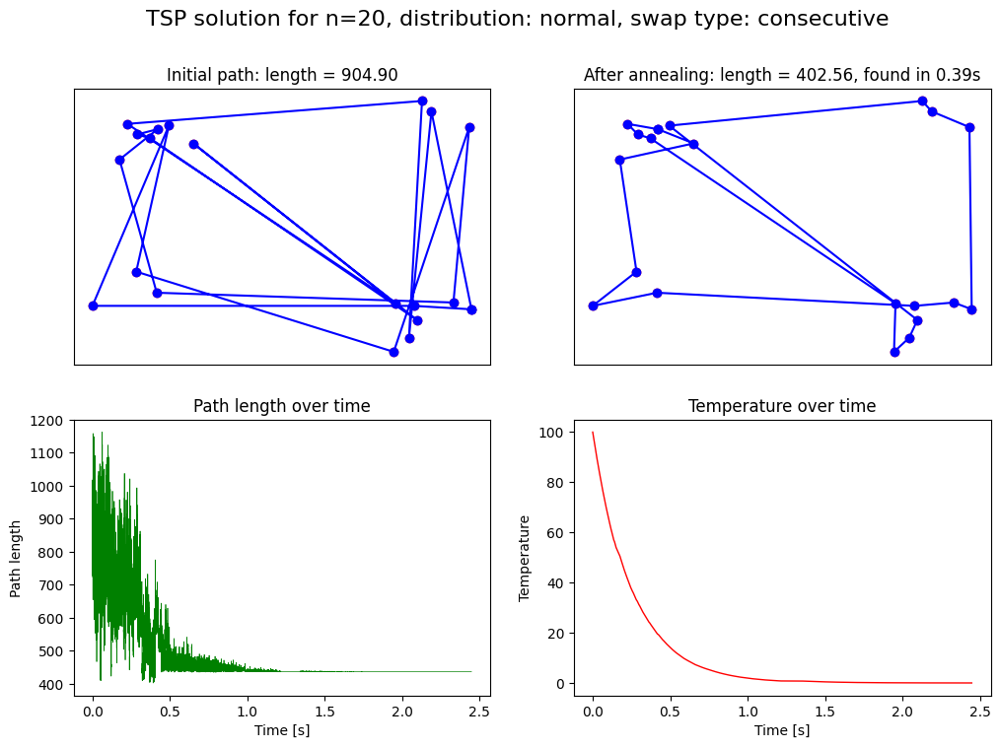

Shortest path comparison for different swap types:
arbitrary: 258.33
consecutive: 402.56

--------------------

Distribution: clusters, swap type: arbitrary
Initial path length: 1450.50
Best path length: 361.73, found in 1.21s
Total elapsed time: 2.82s


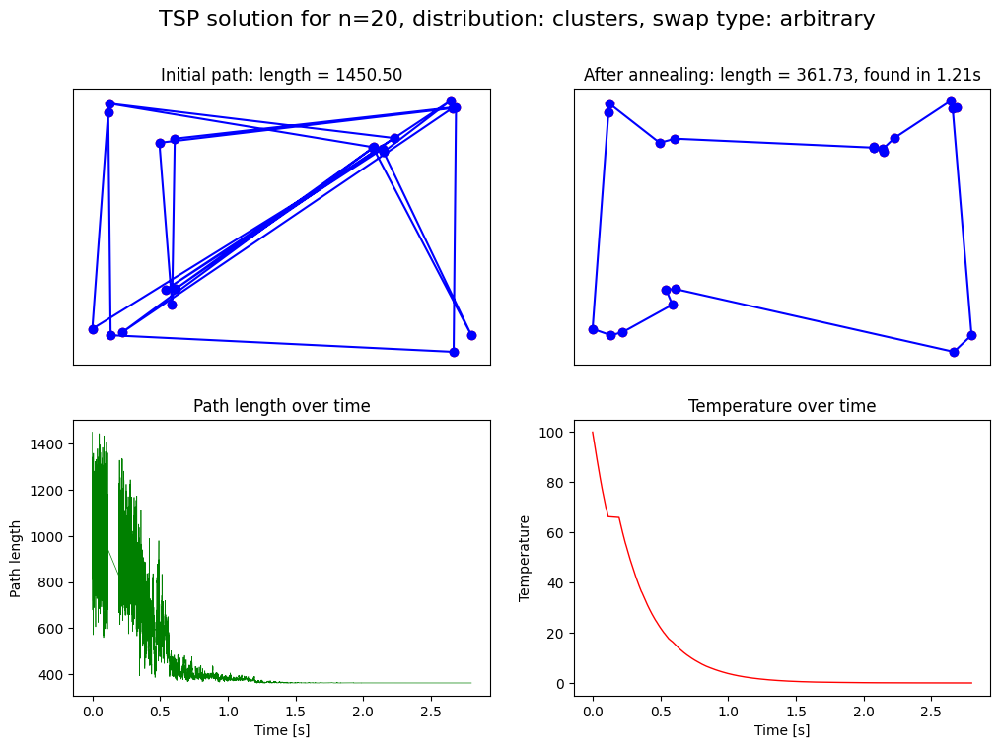

Distribution: clusters, swap type: consecutive
Initial path length: 1180.63
Best path length: 512.24, found in 0.08s
Total elapsed time: 2.49s


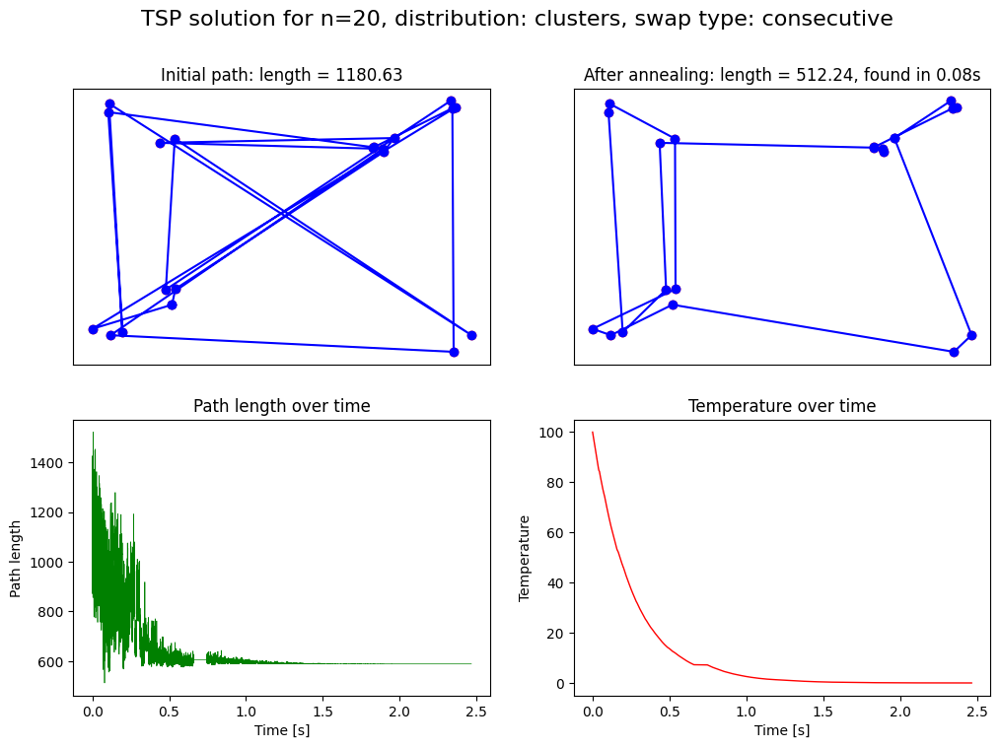

Shortest path comparison for different swap types:
arbitrary: 361.73
consecutive: 512.24

---------- n = 50 ----------

Distribution: uniform, swap type: arbitrary
Initial path length: 2385.50
Best path length: 645.29, found in 2.89s
Total elapsed time: 5.48s


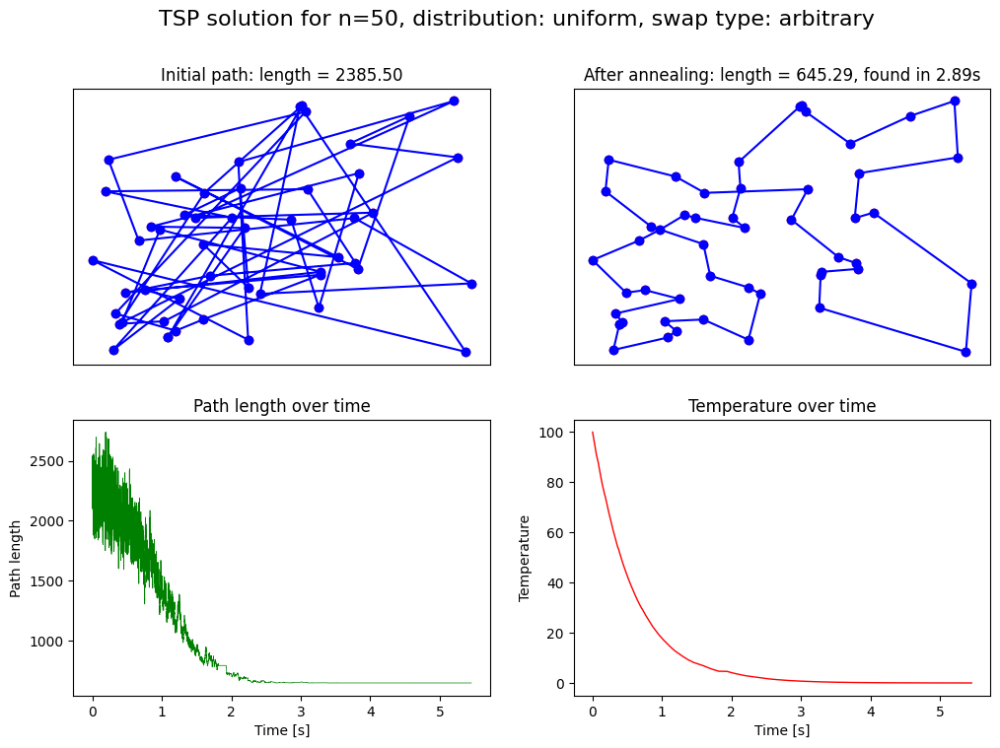

Distribution: uniform, swap type: consecutive
Initial path length: 2494.17
Best path length: 1067.75, found in 2.37s
Total elapsed time: 5.23s


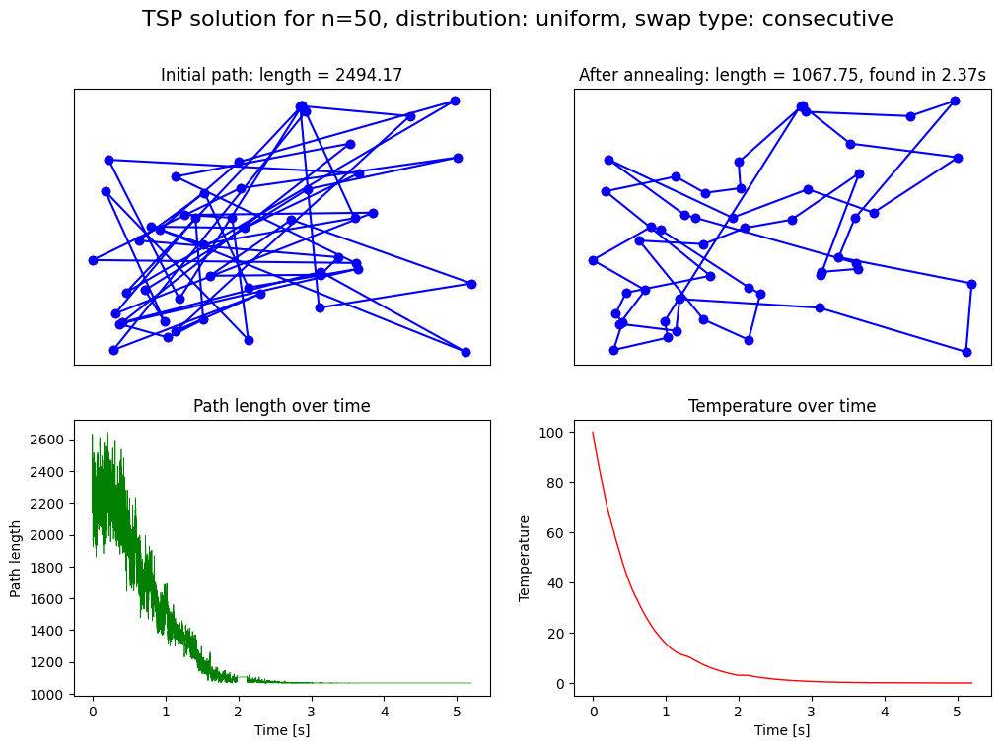

Shortest path comparison for different swap types:
arbitrary: 645.29
consecutive: 1067.75

--------------------

Distribution: normal, swap type: arbitrary
Initial path length: 1676.22
Best path length: 386.49, found in 3.57s
Total elapsed time: 5.59s


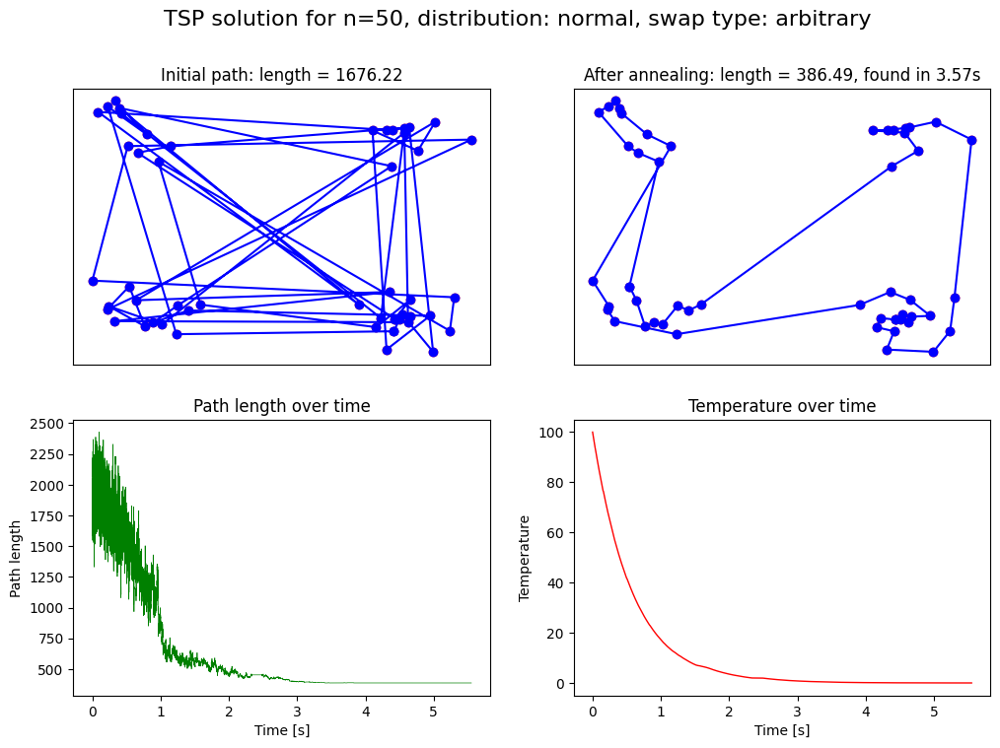

Distribution: normal, swap type: consecutive
Initial path length: 1997.68
Best path length: 841.49, found in 2.07s
Total elapsed time: 5.27s


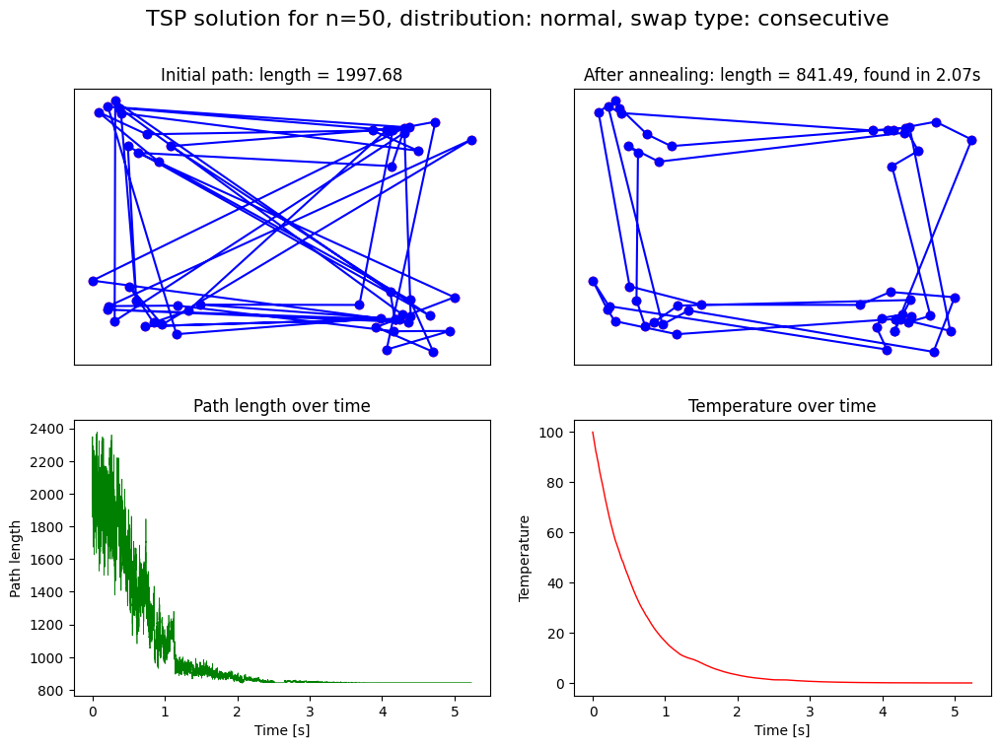

Shortest path comparison for different swap types:
arbitrary: 386.49
consecutive: 841.49

--------------------

Distribution: clusters, swap type: arbitrary
Initial path length: 2725.87
Best path length: 467.70, found in 3.86s
Total elapsed time: 5.60s


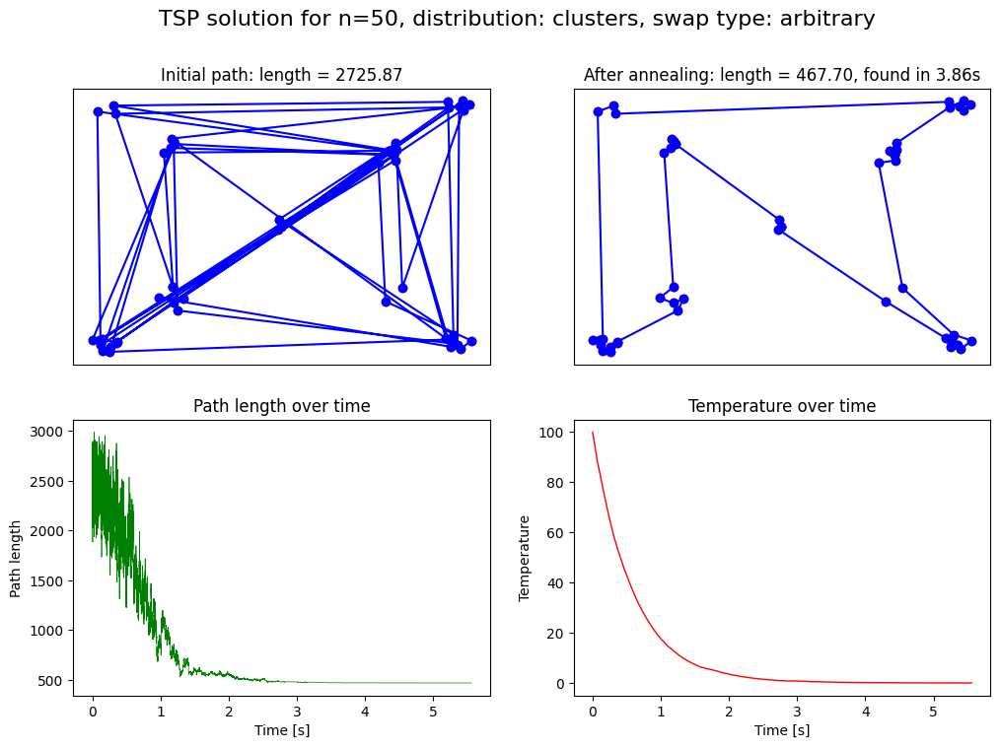

Distribution: clusters, swap type: consecutive
Initial path length: 2965.86
Best path length: 1096.92, found in 1.37s
Total elapsed time: 5.53s


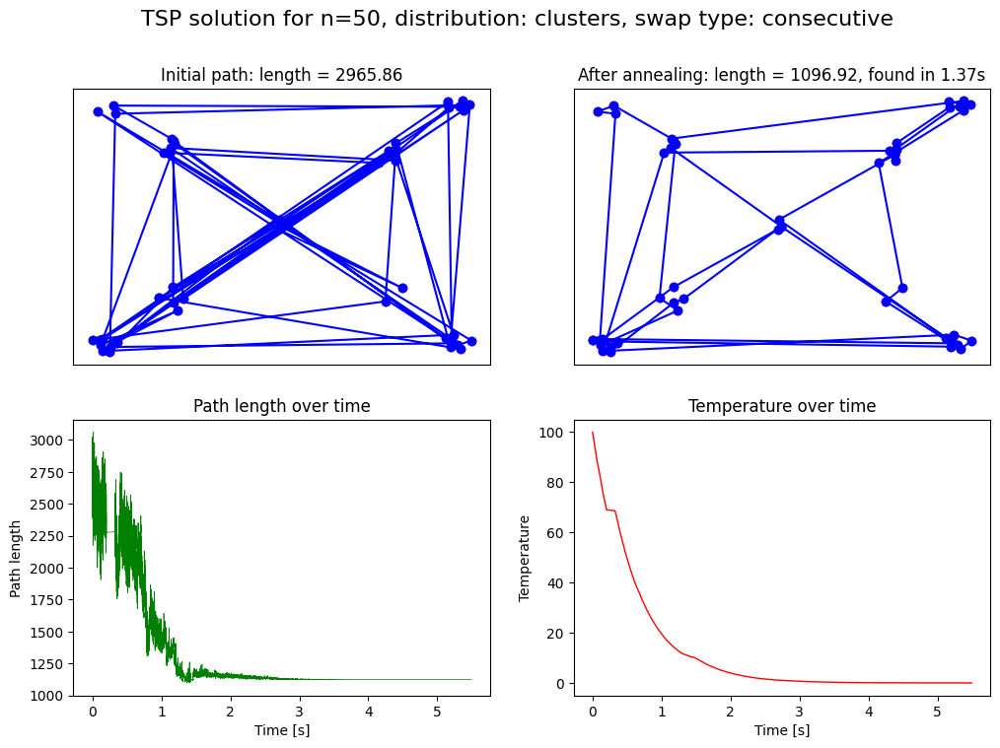

Shortest path comparison for different swap types:
arbitrary: 467.70
consecutive: 1096.92

---------- n = 100 ----------

Distribution: uniform, swap type: arbitrary
Initial path length: 5332.67
Best path length: 1004.48, found in 8.62s
Total elapsed time: 10.17s


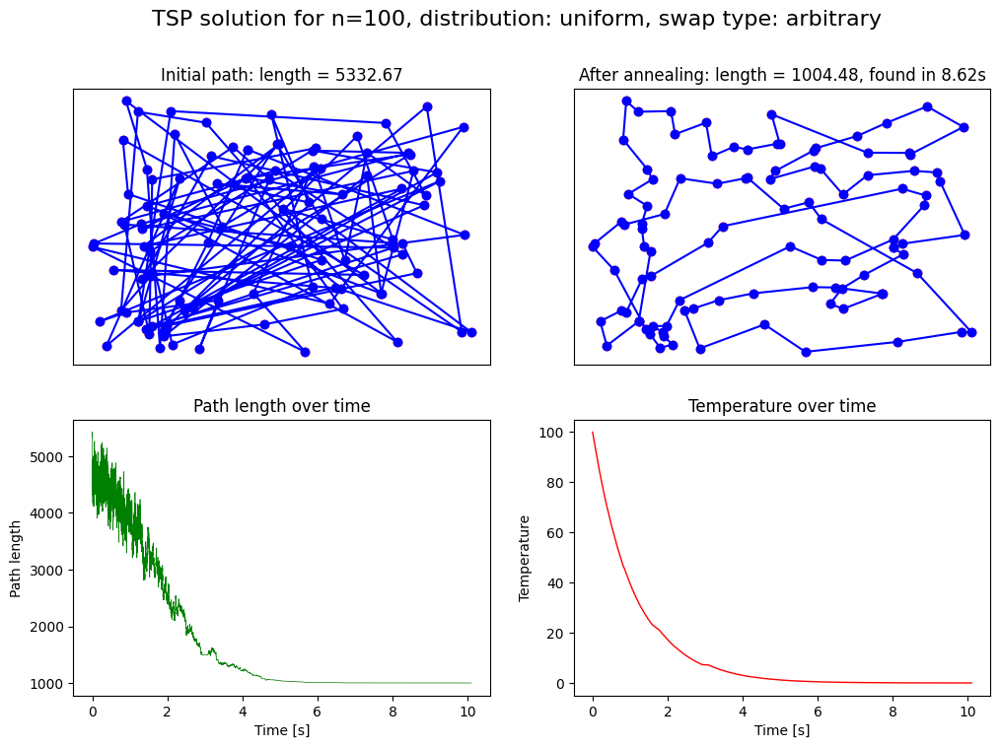

Distribution: uniform, swap type: consecutive
Initial path length: 5140.94
Best path length: 2625.64, found in 4.36s
Total elapsed time: 9.90s


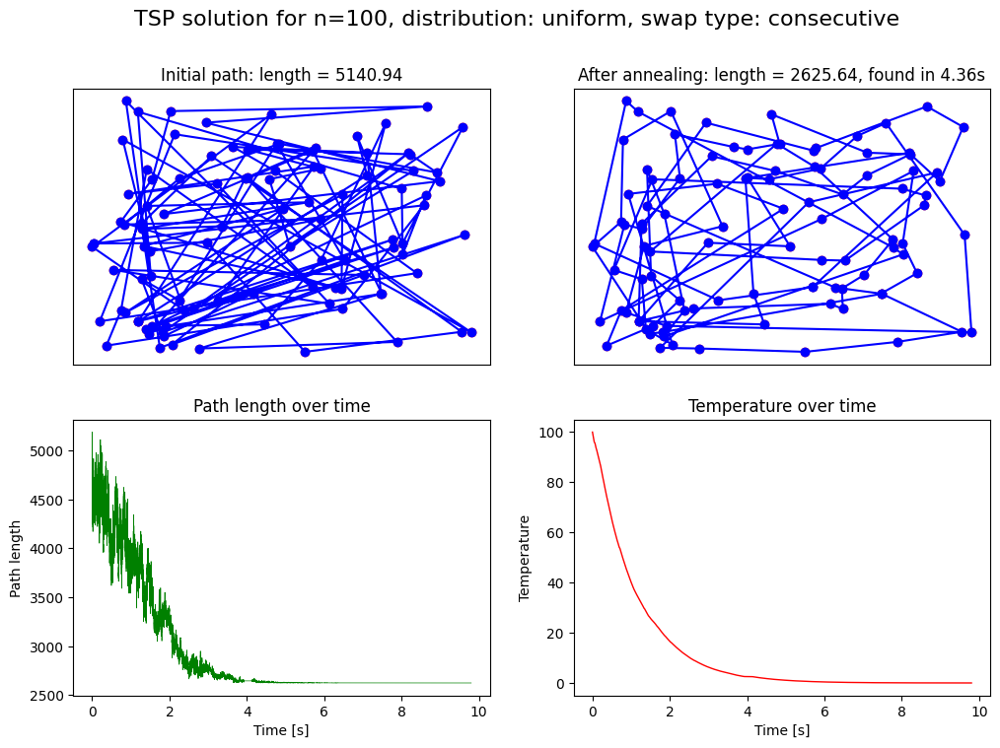

Shortest path comparison for different swap types:
arbitrary: 1004.48
consecutive: 2625.64

--------------------

Distribution: normal, swap type: arbitrary
Initial path length: 4777.78
Best path length: 762.17, found in 8.72s
Total elapsed time: 10.28s


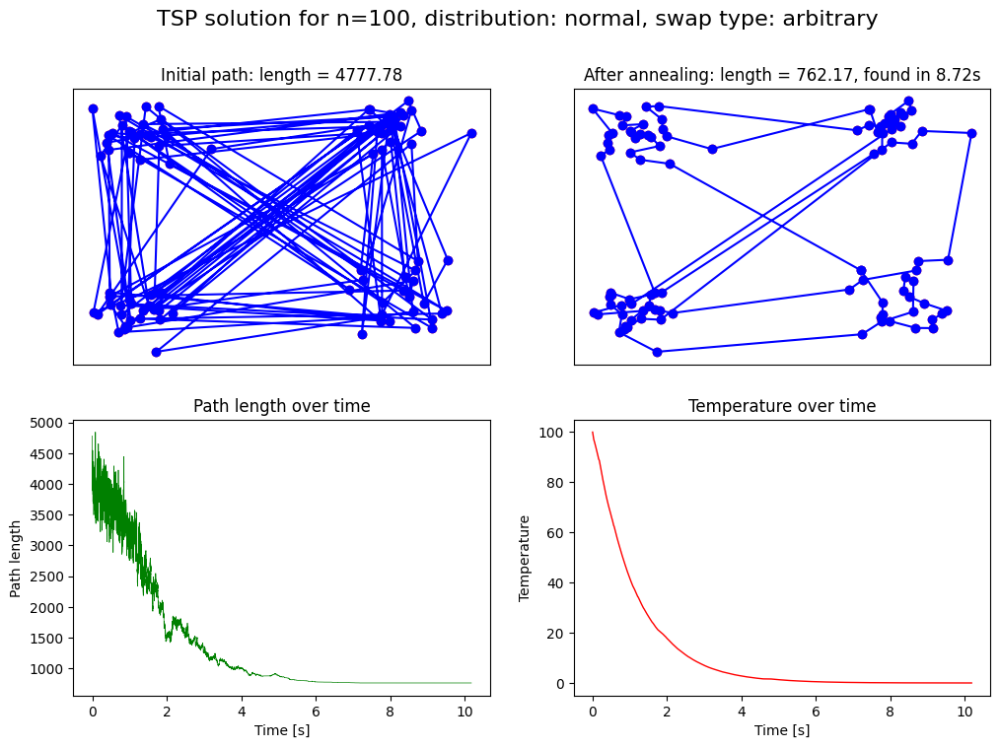

Distribution: normal, swap type: consecutive
Initial path length: 4345.04
Best path length: 2161.55, found in 6.83s
Total elapsed time: 10.38s


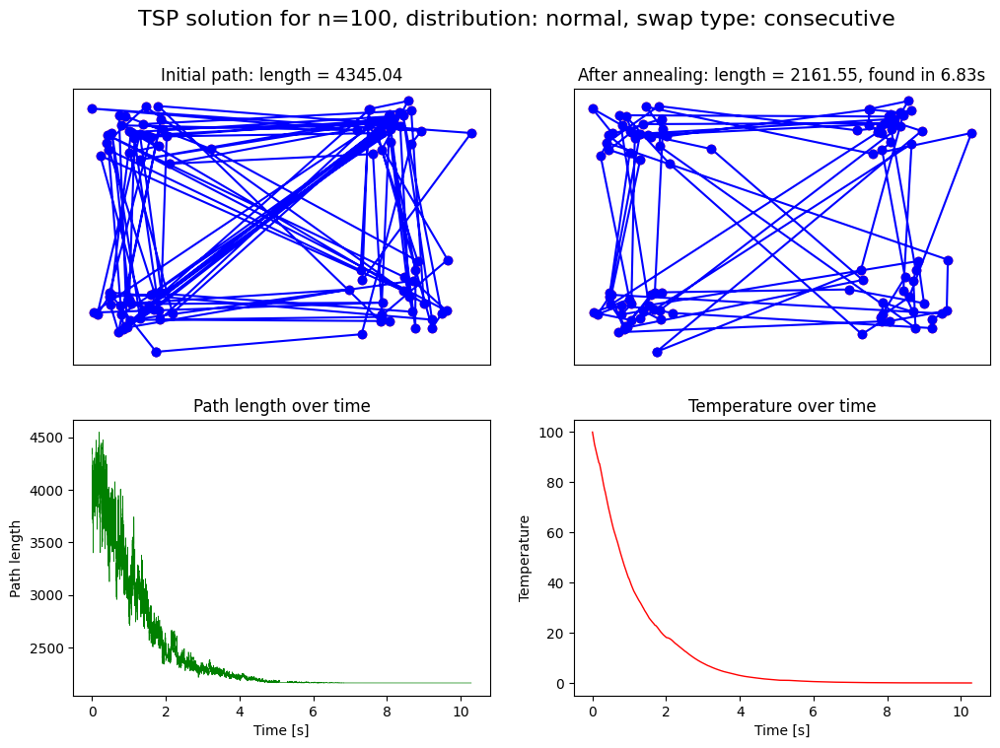

Shortest path comparison for different swap types:
arbitrary: 762.17
consecutive: 2161.55

--------------------

Distribution: clusters, swap type: arbitrary
Initial path length: 5437.87
Best path length: 752.74, found in 9.24s
Total elapsed time: 10.64s


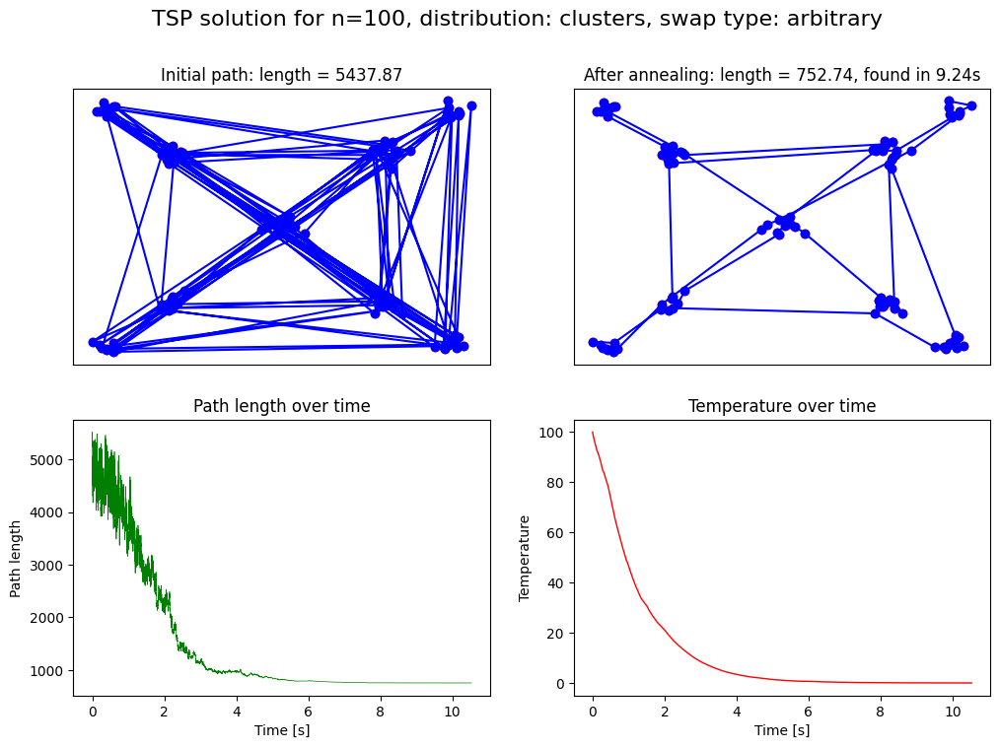

Distribution: clusters, swap type: consecutive
Initial path length: 5261.17
Best path length: 2529.64, found in 5.47s
Total elapsed time: 10.37s


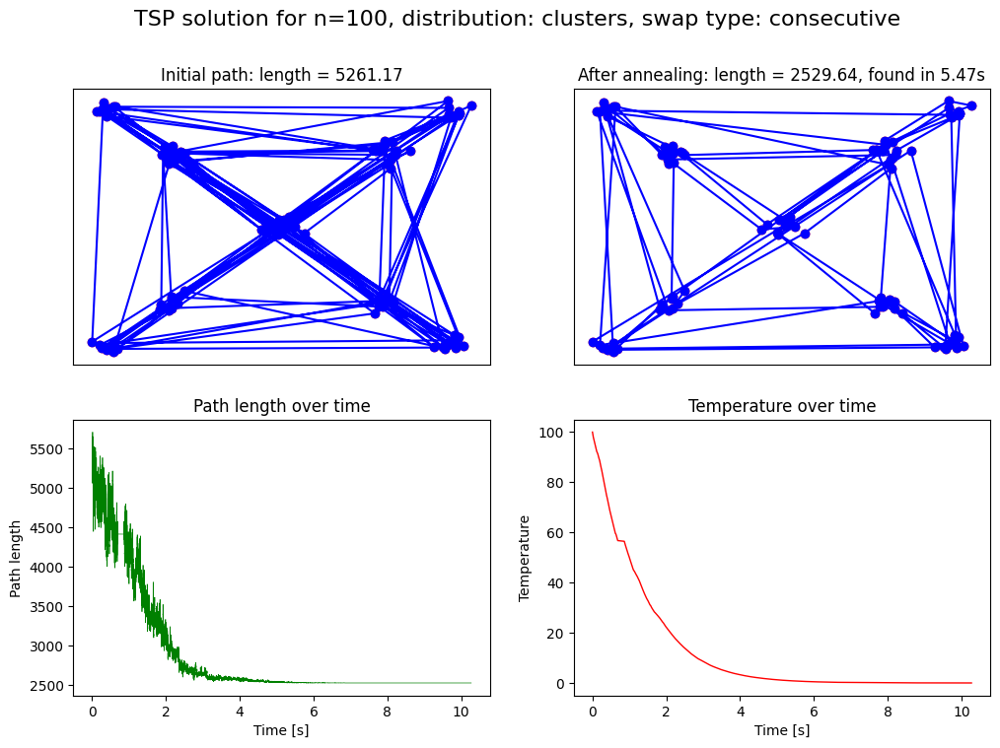

Shortest path comparison for different swap types:
arbitrary: 752.74
consecutive: 2529.64



In [8]:
n_values = [20, 50, 100]
distributions = ["uniform", "normal", "clusters"]
swap_types = ["arbitrary", "consecutive"]

for n in n_values:
    print(f"---------- n = {n} ----------\n")
    for dist in distributions:
        points = generate_points(n, dist)
        results = []
        for swap_type in swap_types:

            start = time.time()
            best_path, best_length, found_time, initial_path, initial_length, lengths, temps, paths =\
                simulated_annealing(points, swap_type=swap_type)
            elapsed = time.time() - start

            results.append((swap_type, best_length))

            print(f"Distribution: {dist}, swap type: {swap_type}")
            print(f"Initial path length: {initial_length:.2f}")
            print(f"Best path length: {best_length:.2f}, found in {found_time:.2f}s")
            print(f"Total elapsed time: {elapsed:.2f}s")

            plot_results(
                points,
                best_path,
                best_length,
                found_time,
                initial_path,
                initial_length,
                lengths,
                temps,
                n,
                dist,
                swap_type
            )

            display(animate(paths, points, best_path, found_time/elapsed))

        print("Shortest path comparison for different swap types:") 
        for swap_type, best_length in results:
            print(f"{swap_type}: {best_length:.2f}")
        print()
        if dist != "clusters":
            print("--------------------\n")

#### Wnioski

Wyniki pokazują, że funkcja zmiany stanu `arbitrary`, mimo dłuższego czasu wykonywania, znajduje znacznie krótsze ścieżki niż `consecutive`.

Swobodniejsze zmiany stanu w funkcji `arbitrary` pozwalają lepiej eksplorować przestrzeń rozwiązań i minimalizują ryzyko "uwięzienia" w lokalnym minimum.

#### 4.2. Porównanie różnych funkcji zmiany temperatury

---------- n = 20 ----------

Distribution: uniform, temperature function: T = 0.999T
Initial path length: 898.79
Best path length: 303.33, found in 1.32s
Total elapsed time: 11.54s


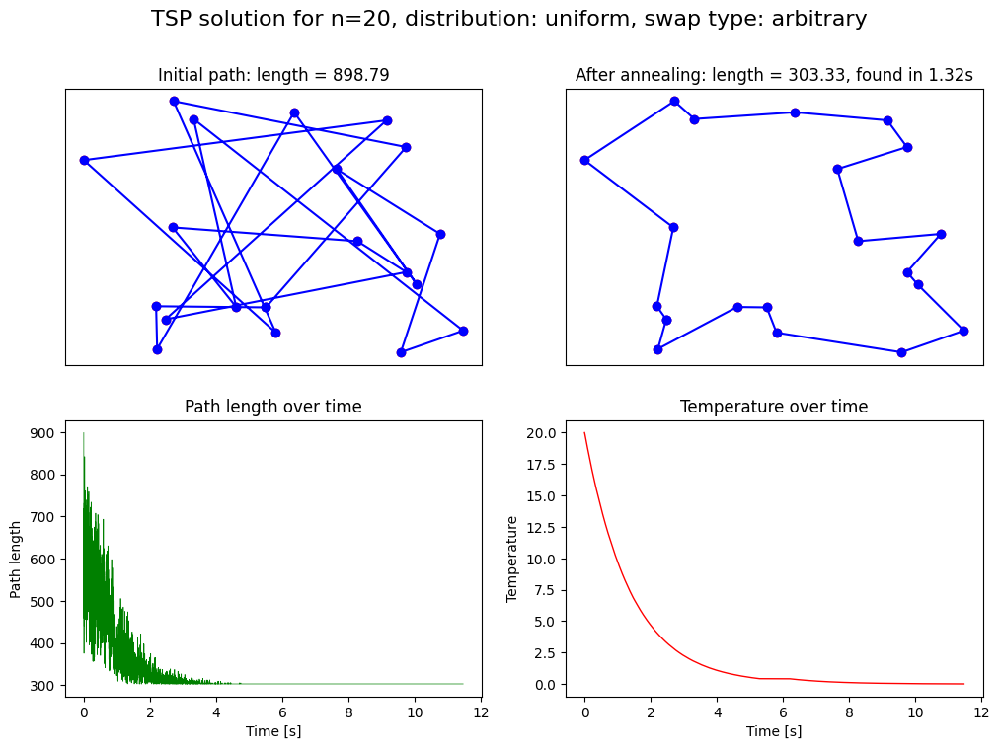

Distribution: uniform, temperature function: T = T_0(1 - t/12)
Initial path length: 923.12
Best path length: 303.33, found in 7.54s
Total elapsed time: 12.08s


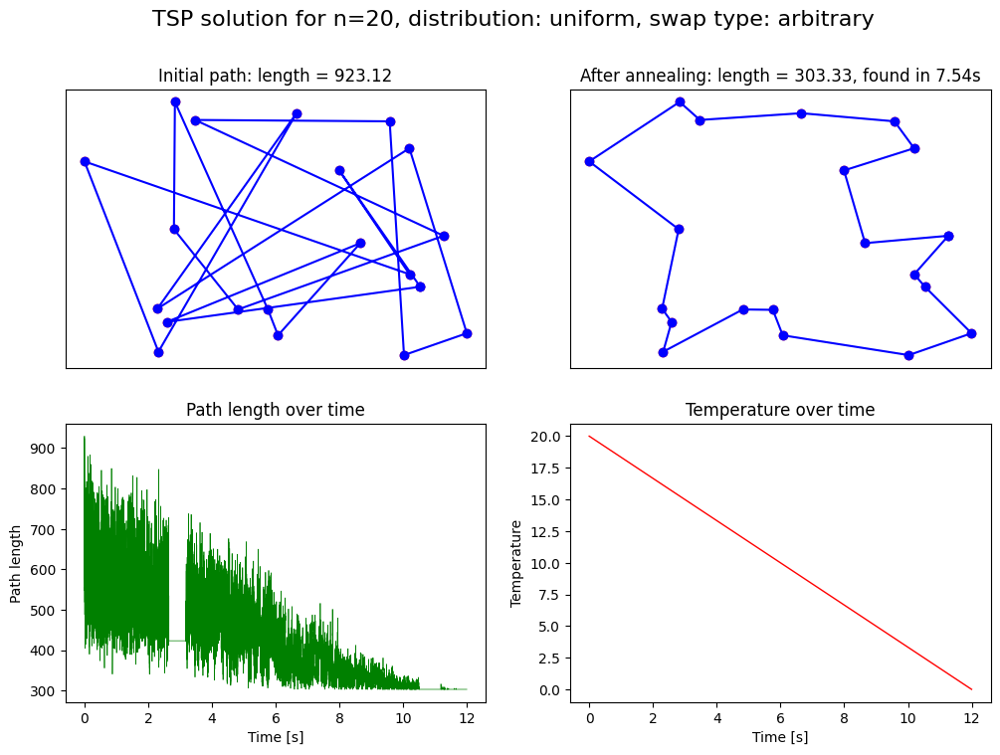

Distribution: uniform, temperature function: T = T_0cos(0.13t)
Initial path length: 1076.32
Best path length: 303.33, found in 9.41s
Total elapsed time: 12.19s


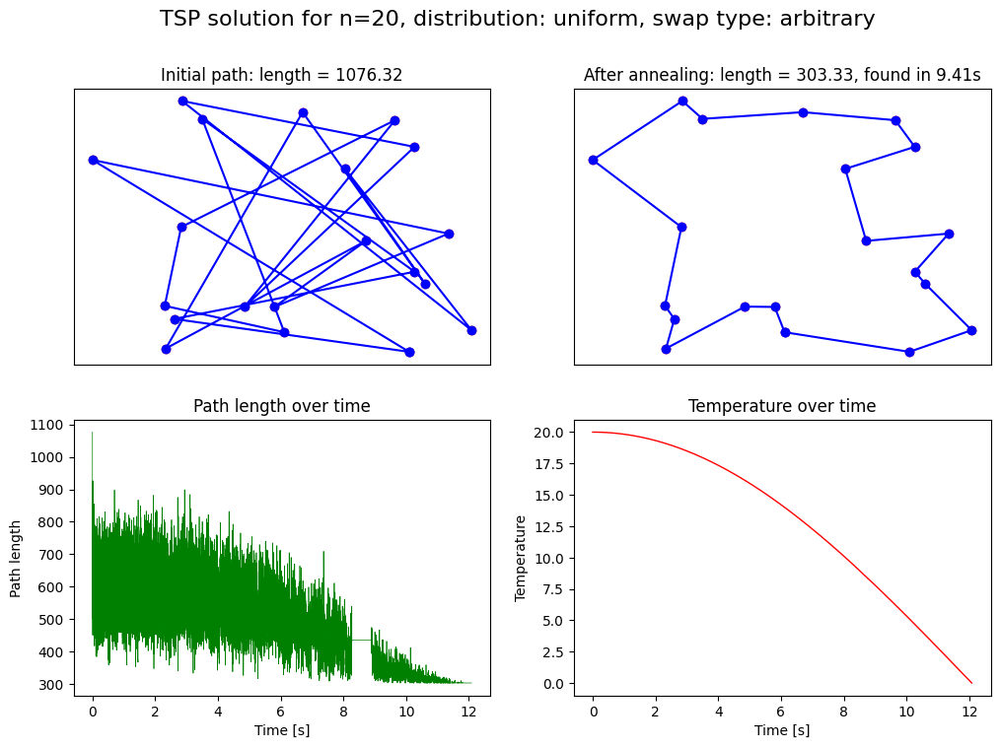

Shortest path comparison for different temperature functions:
T = 0.999T:        303.33, 1.32s
T = T_0(1 - t/12): 303.33, 7.54s
T = T_0cos(0.13t): 303.33, 9.41s

--------------------

Distribution: normal, temperature function: T = 0.999T
Initial path length: 889.90
Best path length: 261.72, found in 1.70s
Total elapsed time: 11.17s


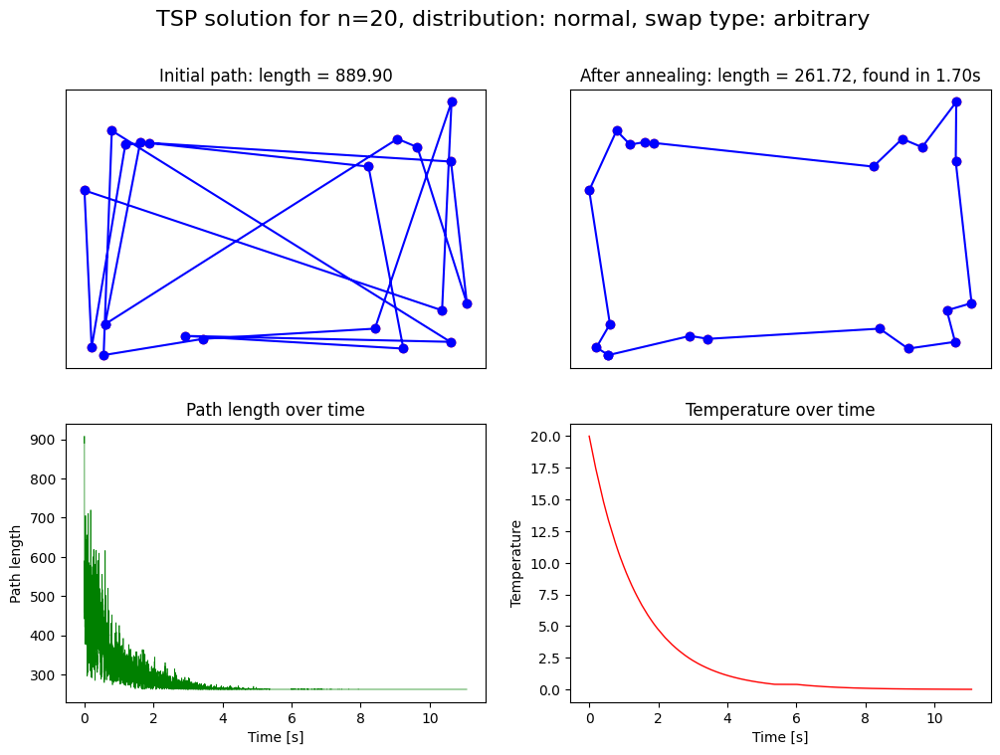

Distribution: normal, temperature function: T = T_0(1 - t/12)
Initial path length: 899.42
Best path length: 261.72, found in 7.06s
Total elapsed time: 12.07s


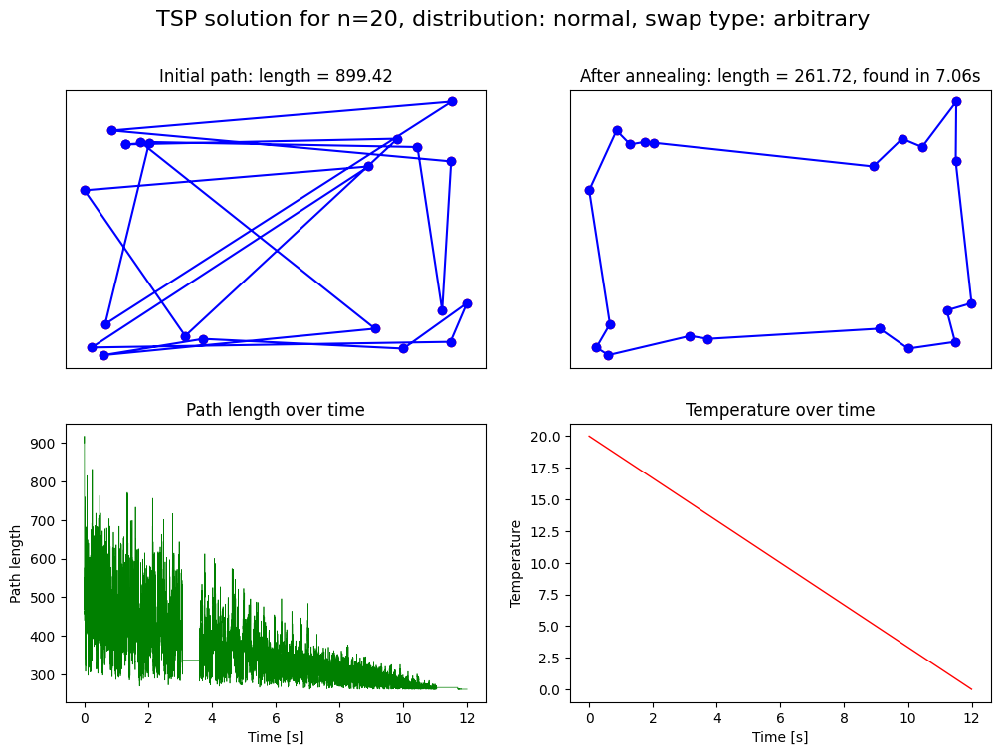

Distribution: normal, temperature function: T = T_0cos(0.13t)
Initial path length: 1007.86
Best path length: 261.72, found in 8.70s
Total elapsed time: 12.18s


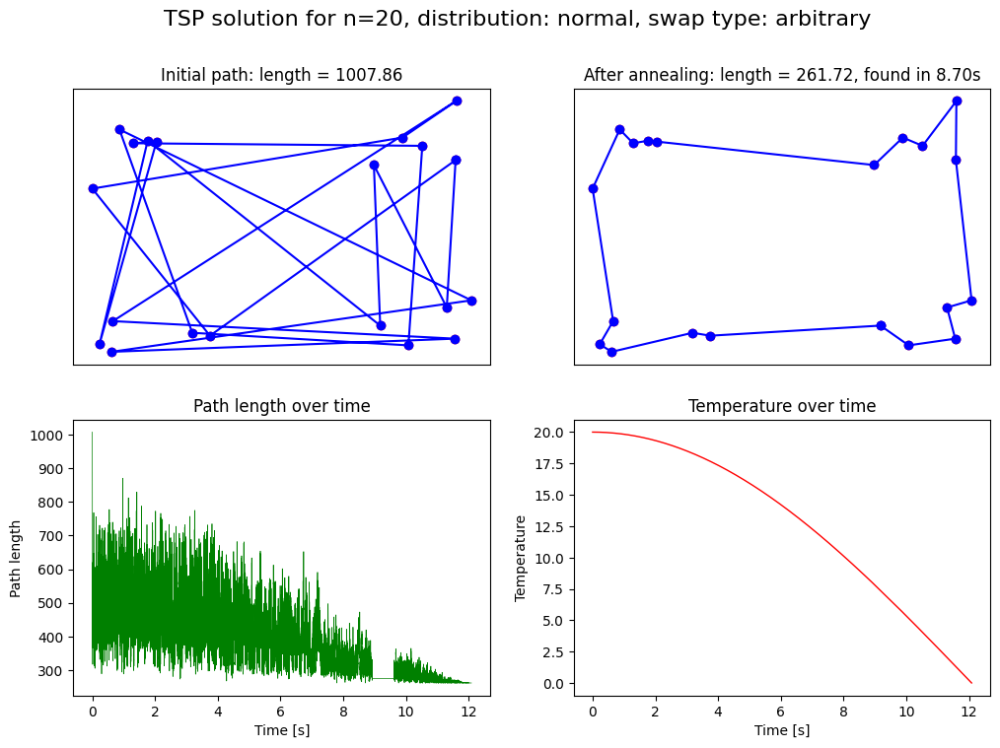

Shortest path comparison for different temperature functions:
T = 0.999T:        261.72, 1.70s
T = T_0(1 - t/12): 261.72, 7.06s
T = T_0cos(0.13t): 261.72, 8.70s

--------------------

Distribution: clusters, temperature function: T = 0.999T
Initial path length: 1256.79
Best path length: 368.17, found in 2.94s
Total elapsed time: 11.34s


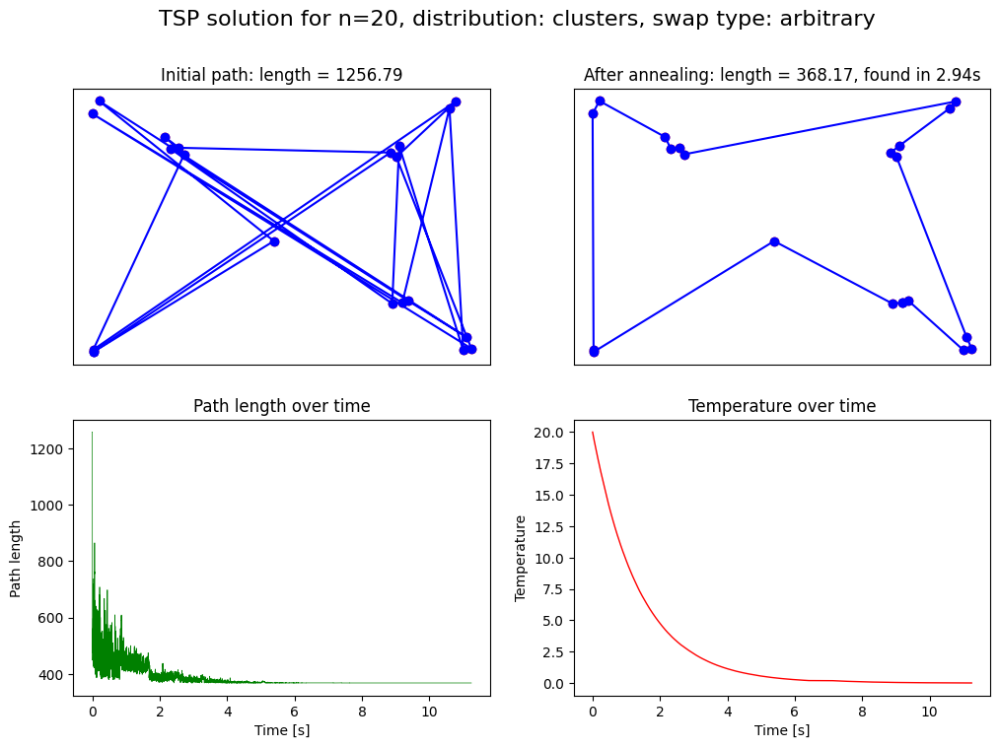

Distribution: clusters, temperature function: T = T_0(1 - t/12)
Initial path length: 1155.51
Best path length: 370.74, found in 6.86s
Total elapsed time: 12.08s


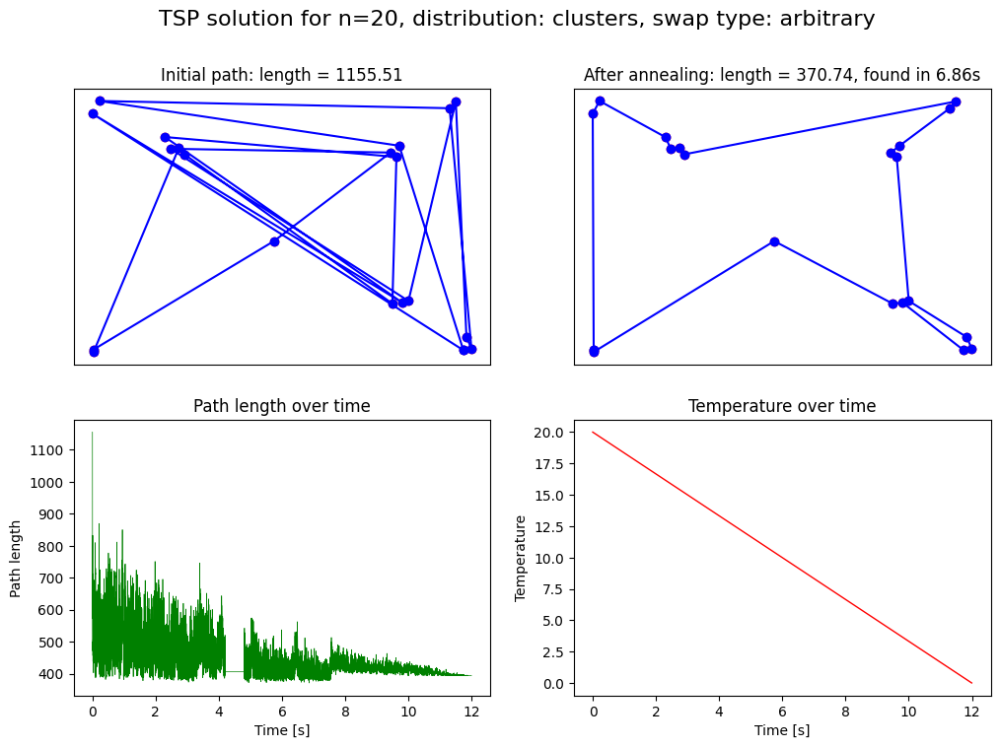

Distribution: clusters, temperature function: T = T_0cos(0.13t)
Initial path length: 1181.76
Best path length: 368.17, found in 8.94s
Total elapsed time: 12.17s


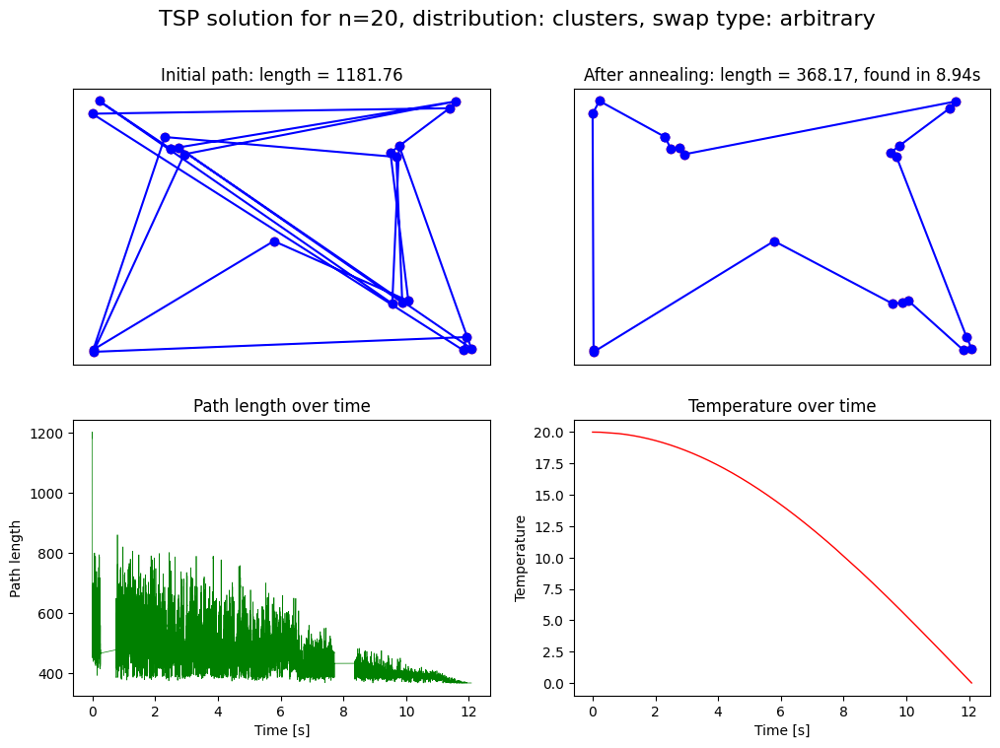

Shortest path comparison for different temperature functions:
T = 0.999T:        368.17, 2.94s
T = T_0(1 - t/12): 370.74, 6.86s
T = T_0cos(0.13t): 368.17, 8.94s

---------- n = 50 ----------

Distribution: uniform, temperature function: T = 0.999T
Initial path length: 2869.59
Best path length: 653.28, found in 7.24s
Total elapsed time: 22.48s


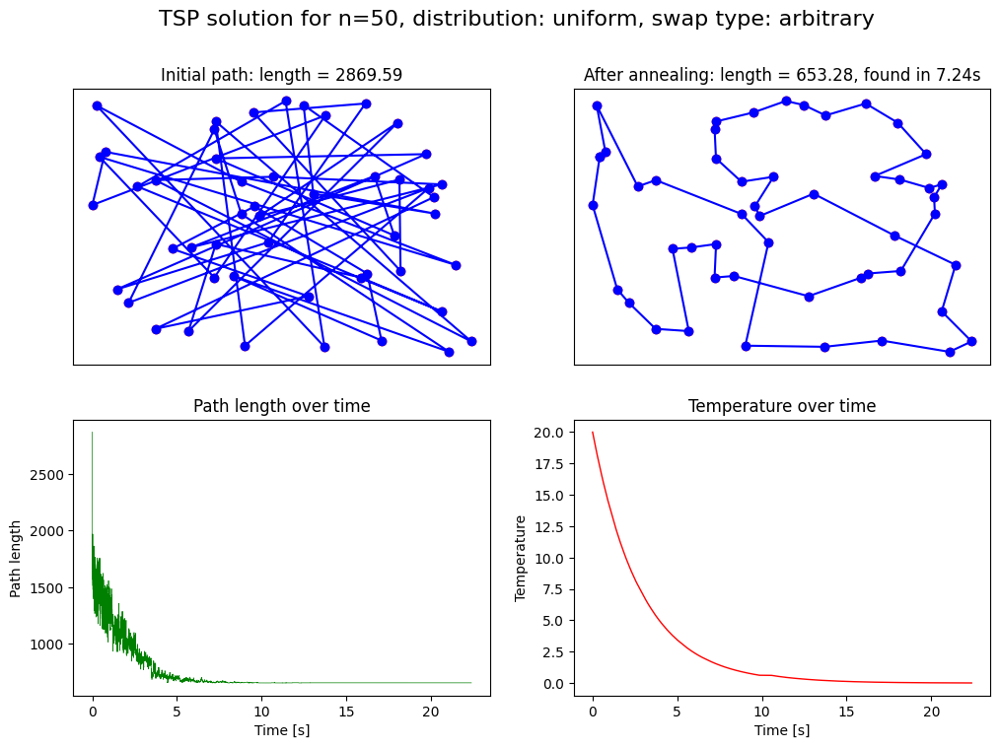

Distribution: uniform, temperature function: T = T_0(1 - t/12)
Initial path length: 2381.57
Best path length: 594.01, found in 10.06s
Total elapsed time: 12.11s


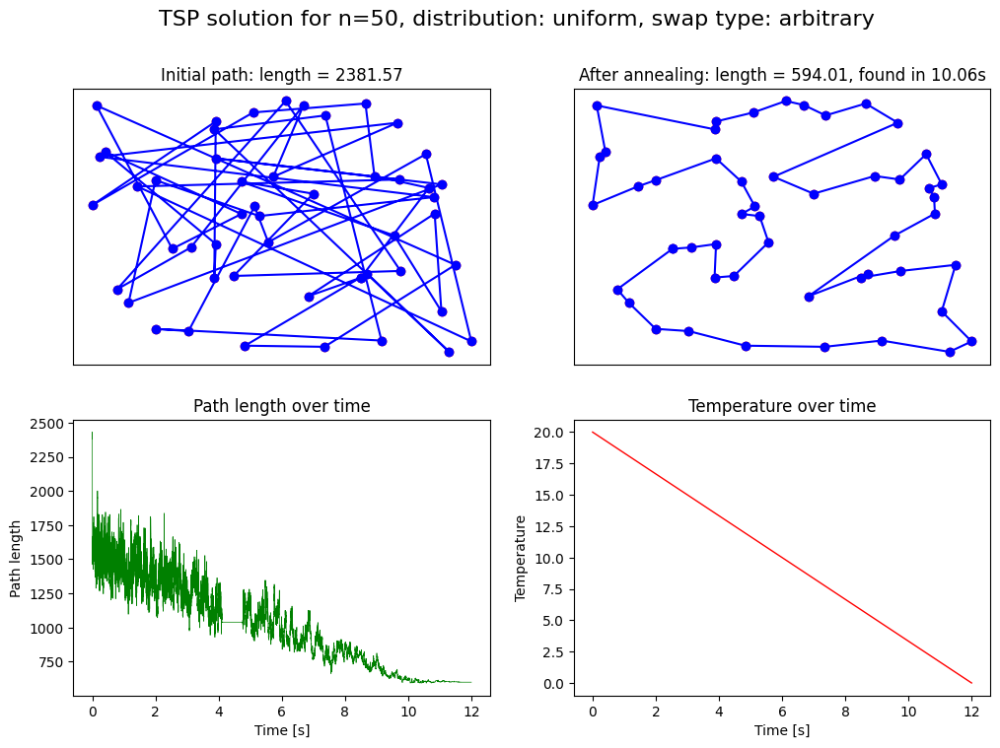

Distribution: uniform, temperature function: T = T_0cos(0.13t)
Initial path length: 2735.17
Best path length: 615.84, found in 11.44s
Total elapsed time: 12.16s


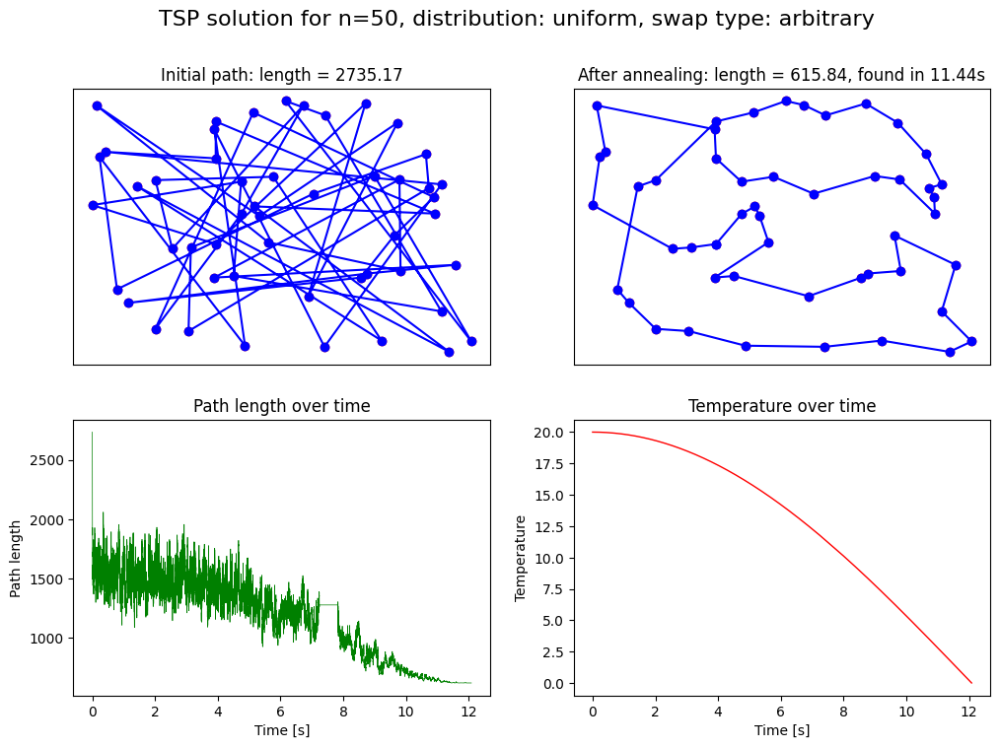

Shortest path comparison for different temperature functions:
T = 0.999T:        653.28, 7.24s
T = T_0(1 - t/12): 594.01, 10.06s
T = T_0cos(0.13t): 615.84, 11.44s

--------------------

Distribution: normal, temperature function: T = 0.999T
Initial path length: 2132.17
Best path length: 370.50, found in 10.44s
Total elapsed time: 23.02s


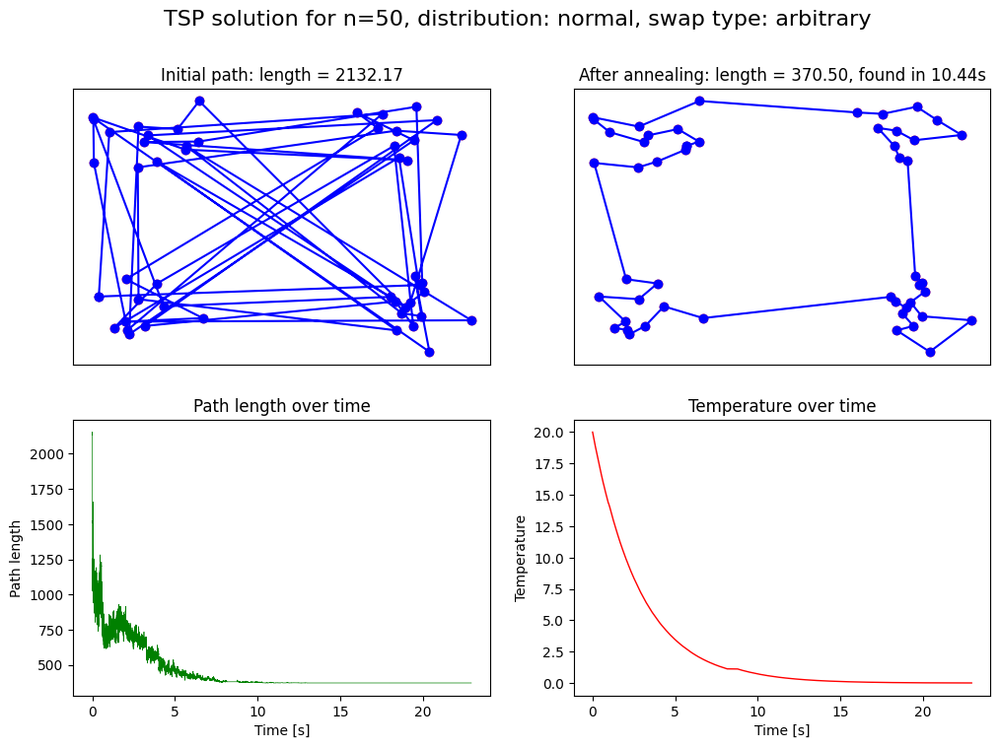

Distribution: normal, temperature function: T = T_0(1 - t/12)
Initial path length: 2186.66
Best path length: 429.85, found in 11.73s
Total elapsed time: 12.12s


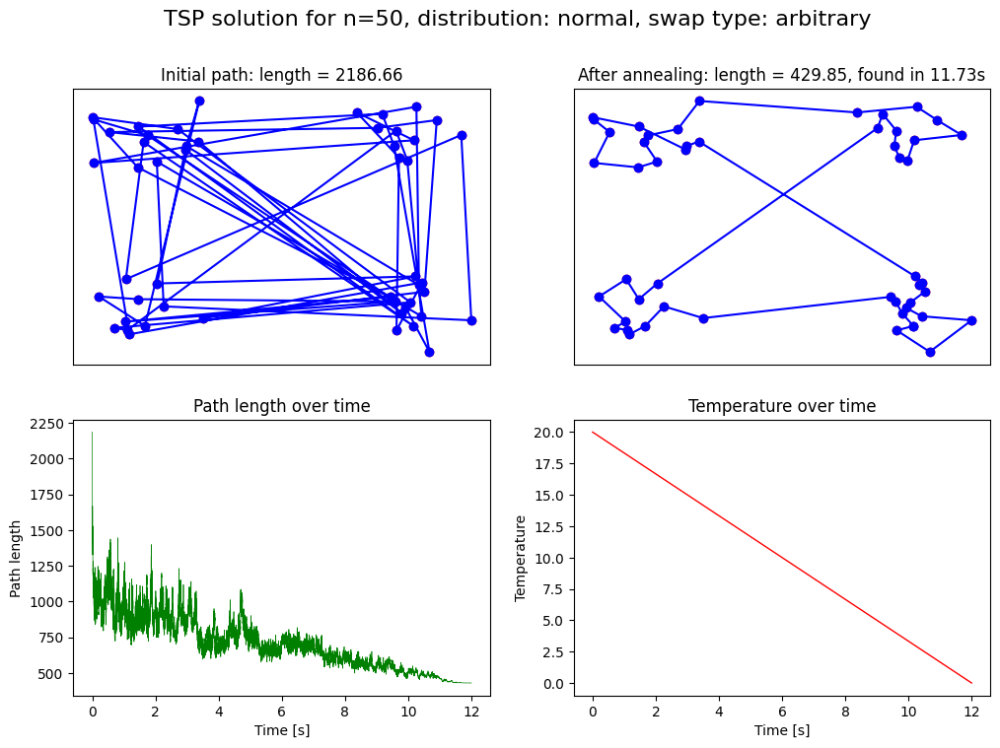

Distribution: normal, temperature function: T = T_0cos(0.13t)
Initial path length: 2400.33
Best path length: 386.64, found in 12.05s
Total elapsed time: 12.15s


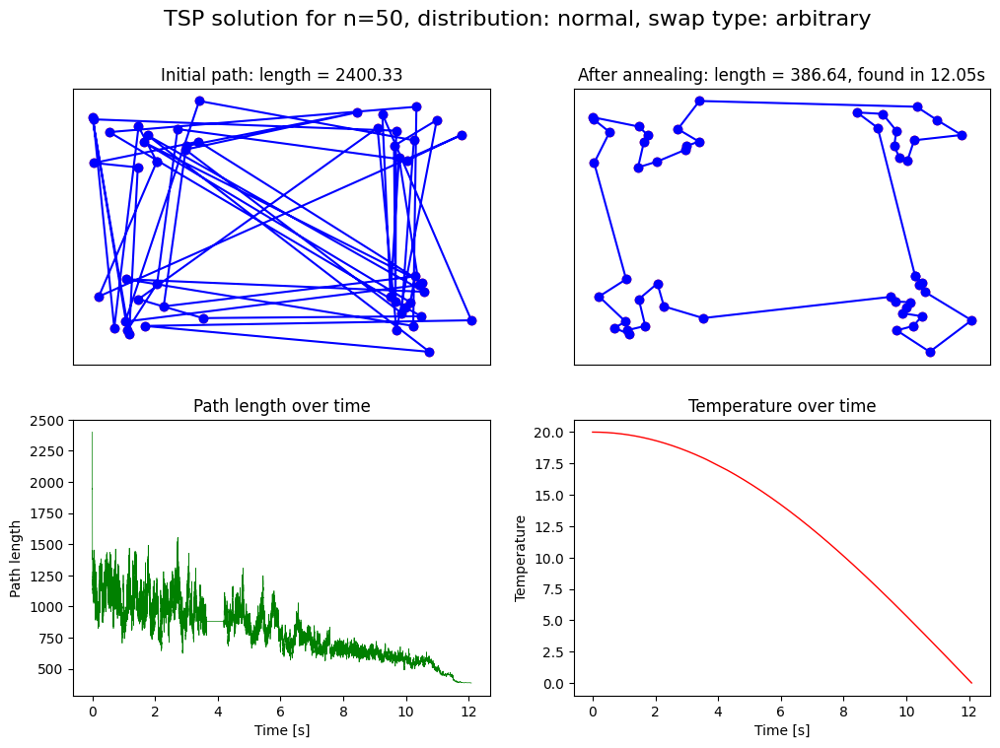

Shortest path comparison for different temperature functions:
T = 0.999T:        370.50, 10.44s
T = T_0(1 - t/12): 429.85, 11.73s
T = T_0cos(0.13t): 386.64, 12.05s

--------------------

Distribution: clusters, temperature function: T = 0.999T
Initial path length: 2853.76
Best path length: 461.96, found in 11.98s
Total elapsed time: 22.98s


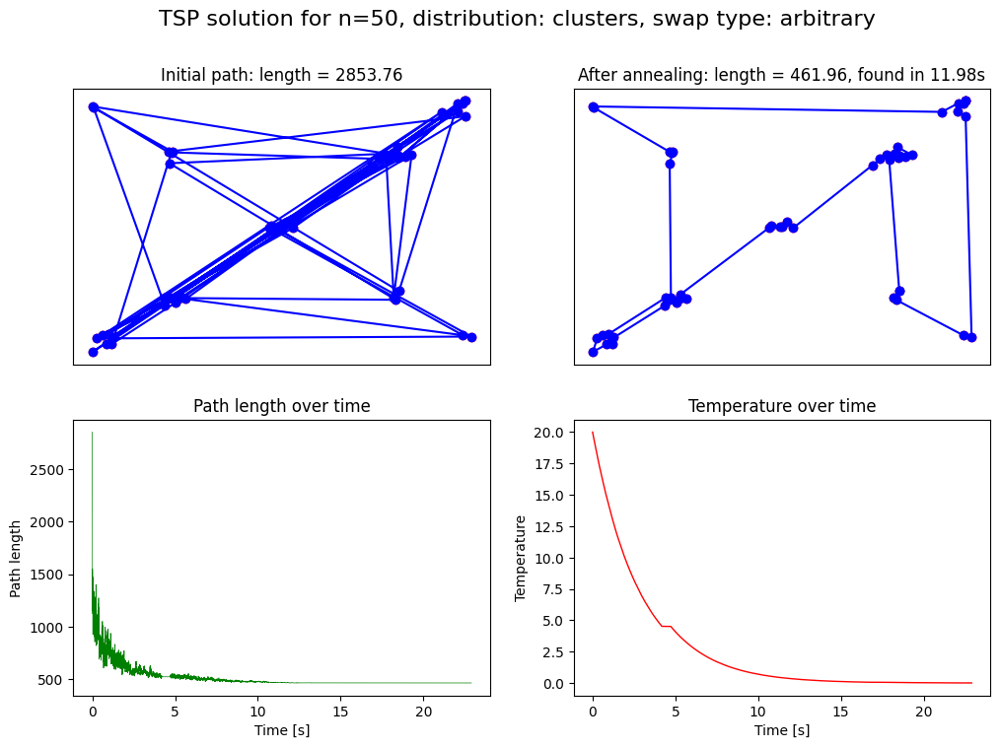

Distribution: clusters, temperature function: T = T_0(1 - t/12)
Initial path length: 2909.49
Best path length: 446.76, found in 11.99s
Total elapsed time: 12.11s


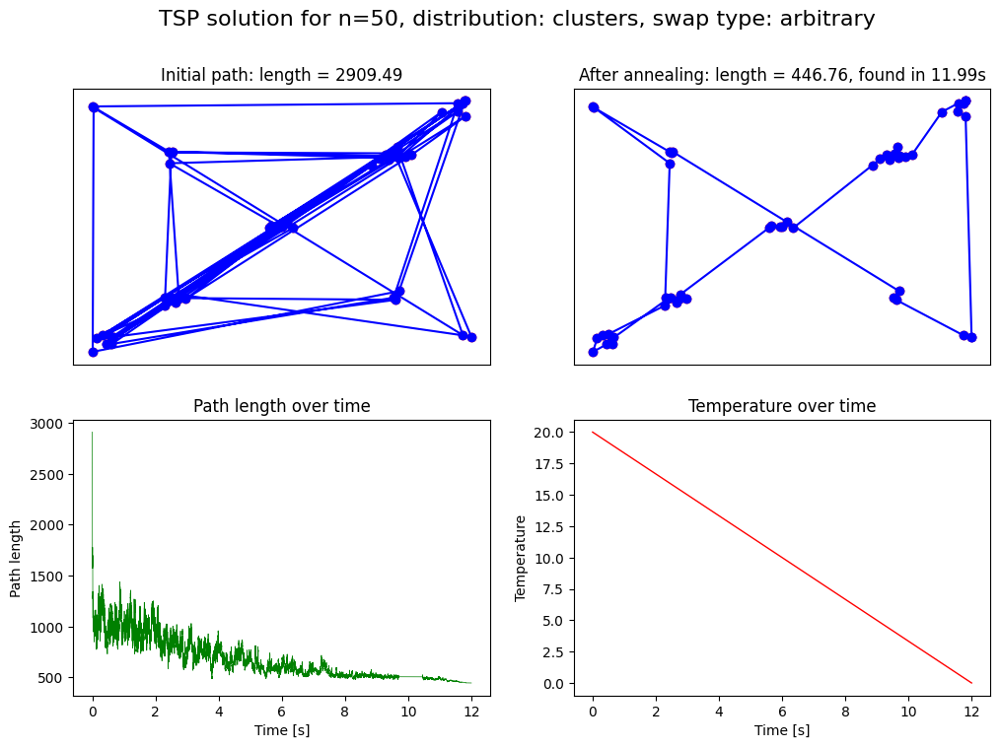

Distribution: clusters, temperature function: T = T_0cos(0.13t)
Initial path length: 2861.99
Best path length: 441.79, found in 12.07s
Total elapsed time: 12.16s


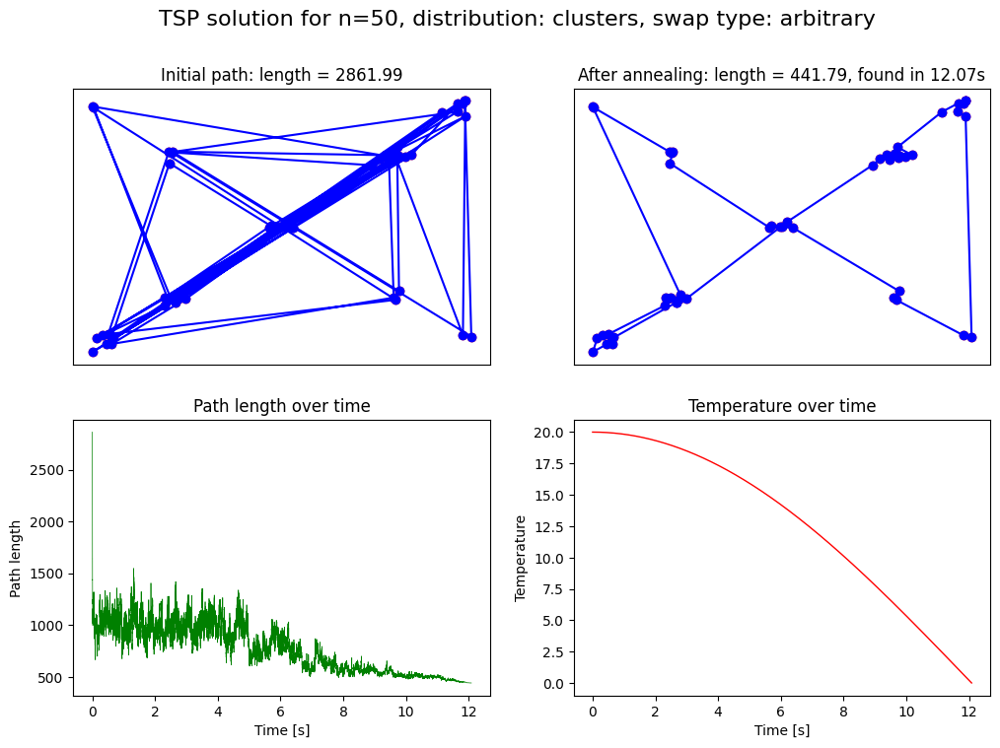

Shortest path comparison for different temperature functions:
T = 0.999T:        461.96, 11.98s
T = T_0(1 - t/12): 446.76, 11.99s
T = T_0cos(0.13t): 441.79, 12.07s

---------- n = 100 ----------

Distribution: uniform, temperature function: T = 0.999T
Initial path length: 5108.70
Best path length: 997.01, found in 26.59s
Total elapsed time: 41.71s


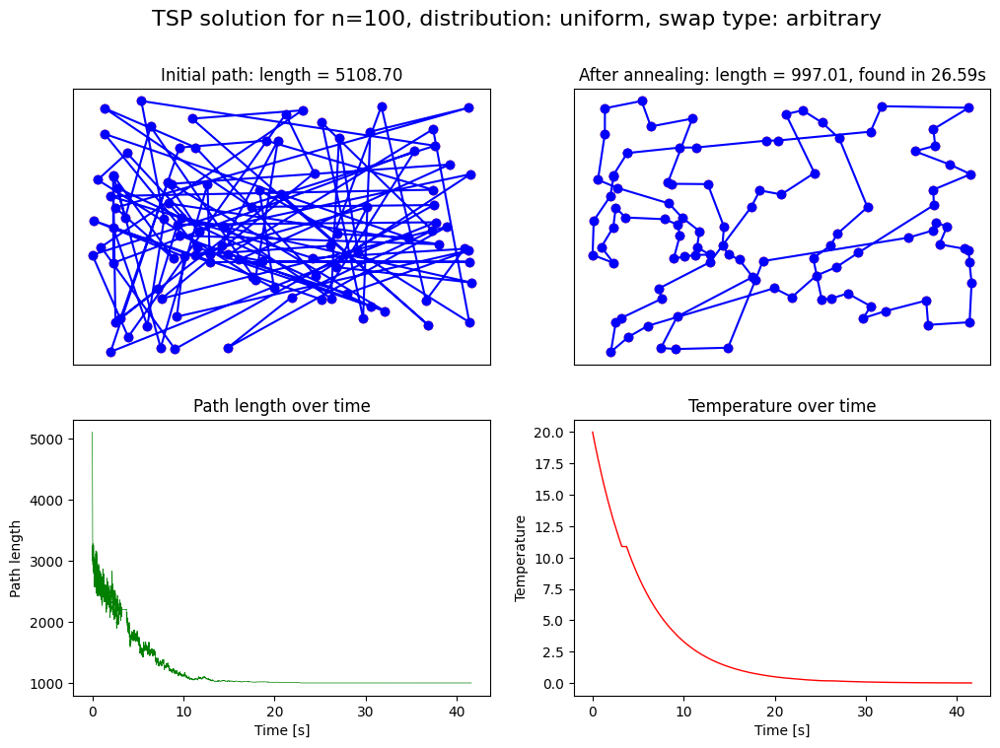

Distribution: uniform, temperature function: T = T_0(1 - t/12)
Initial path length: 5078.24
Best path length: 946.07, found in 11.50s
Total elapsed time: 12.74s


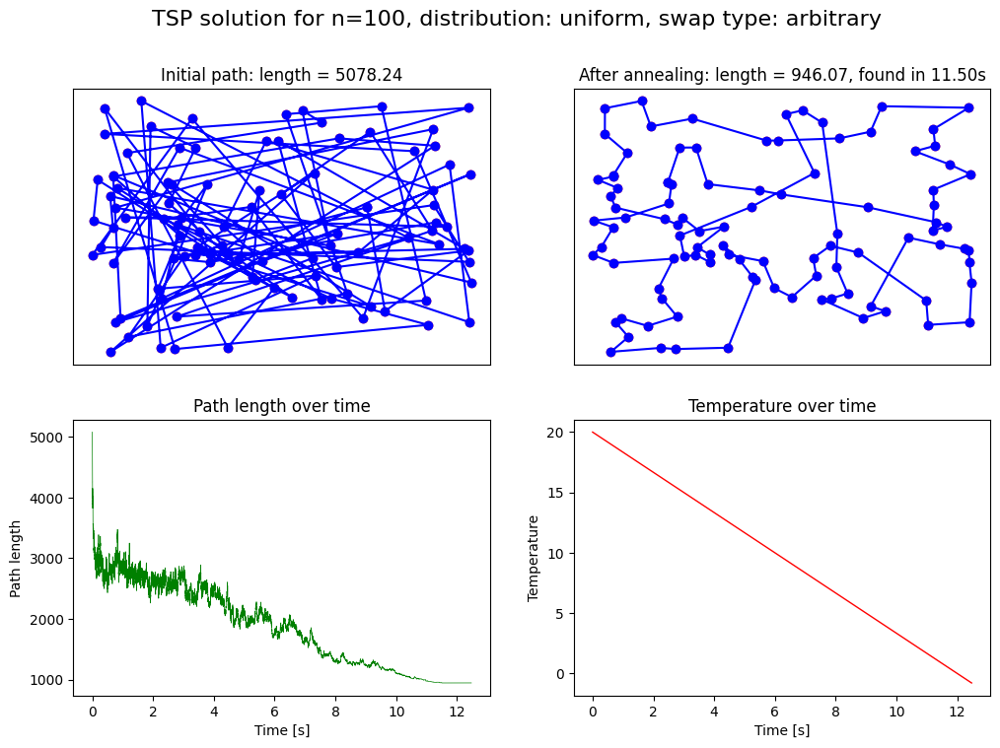

Distribution: uniform, temperature function: T = T_0cos(0.13t)
Initial path length: 4766.97
Best path length: 961.56, found in 12.07s
Total elapsed time: 12.19s


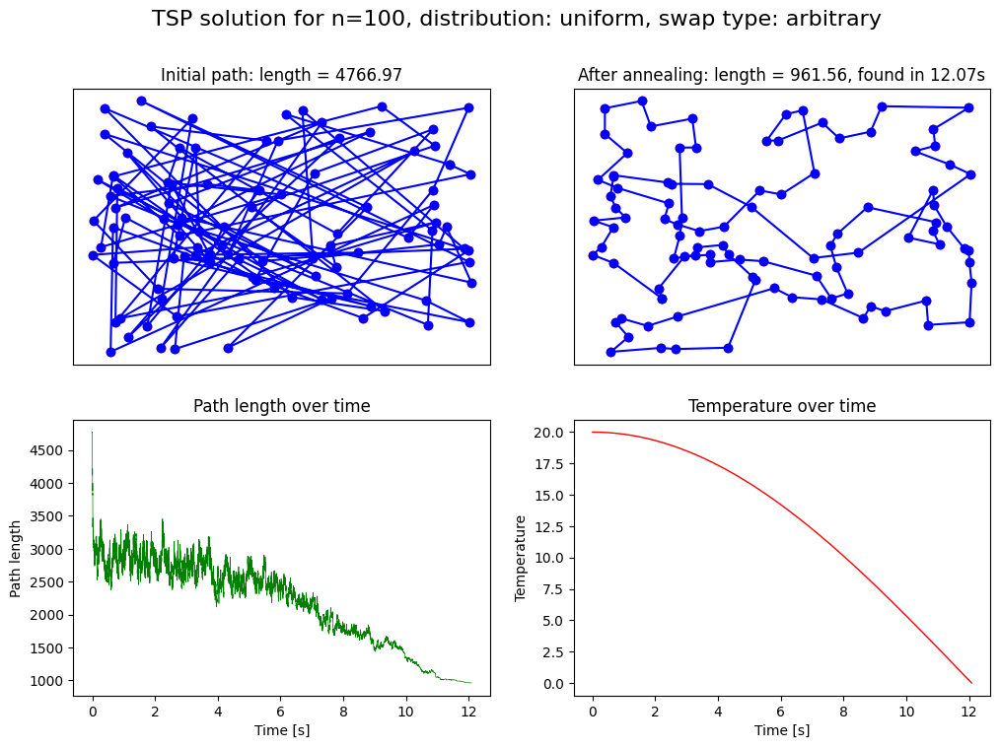

Shortest path comparison for different temperature functions:
T = 0.999T:        997.01, 26.59s
T = T_0(1 - t/12): 946.07, 11.50s
T = T_0cos(0.13t): 961.56, 12.07s

--------------------

Distribution: normal, temperature function: T = 0.999T
Initial path length: 4556.15
Best path length: 603.63, found in 23.25s
Total elapsed time: 41.70s


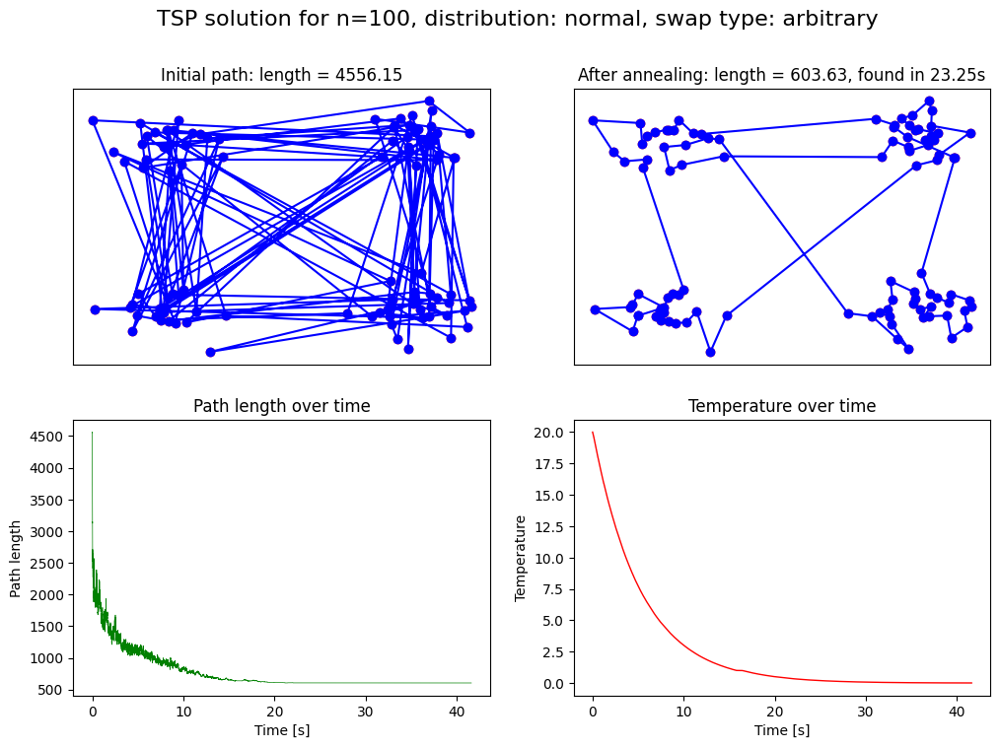

Distribution: normal, temperature function: T = T_0(1 - t/12)
Initial path length: 4418.92
Best path length: 718.14, found in 11.97s
Total elapsed time: 12.27s


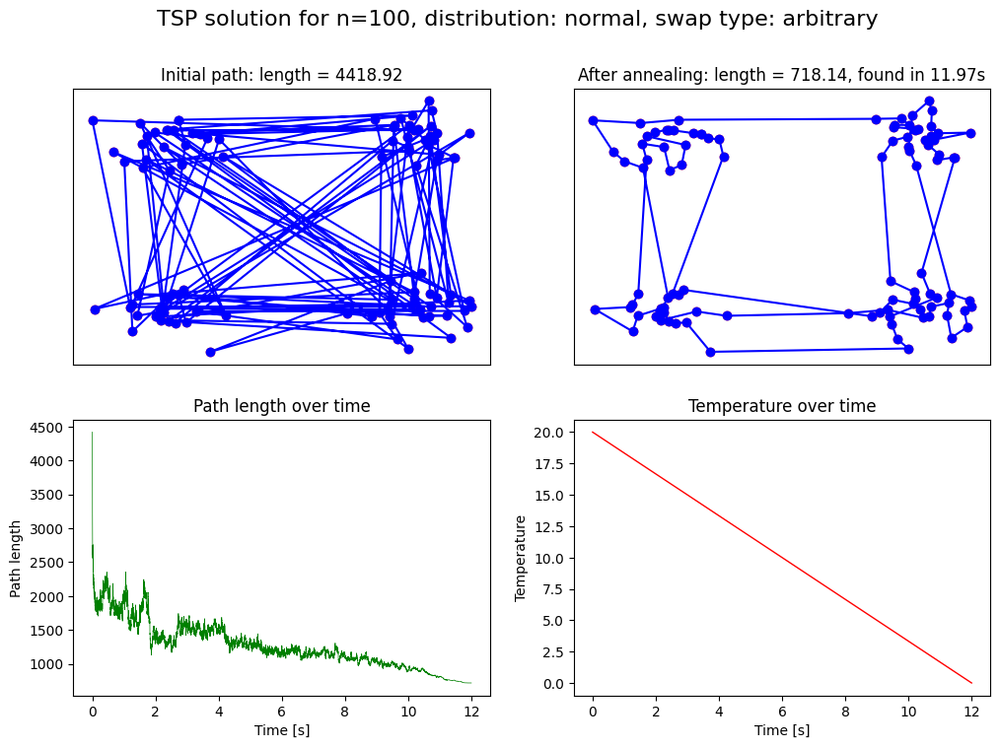

Distribution: normal, temperature function: T = T_0cos(0.13t)
Initial path length: 4537.45
Best path length: 682.75, found in 12.05s
Total elapsed time: 12.19s


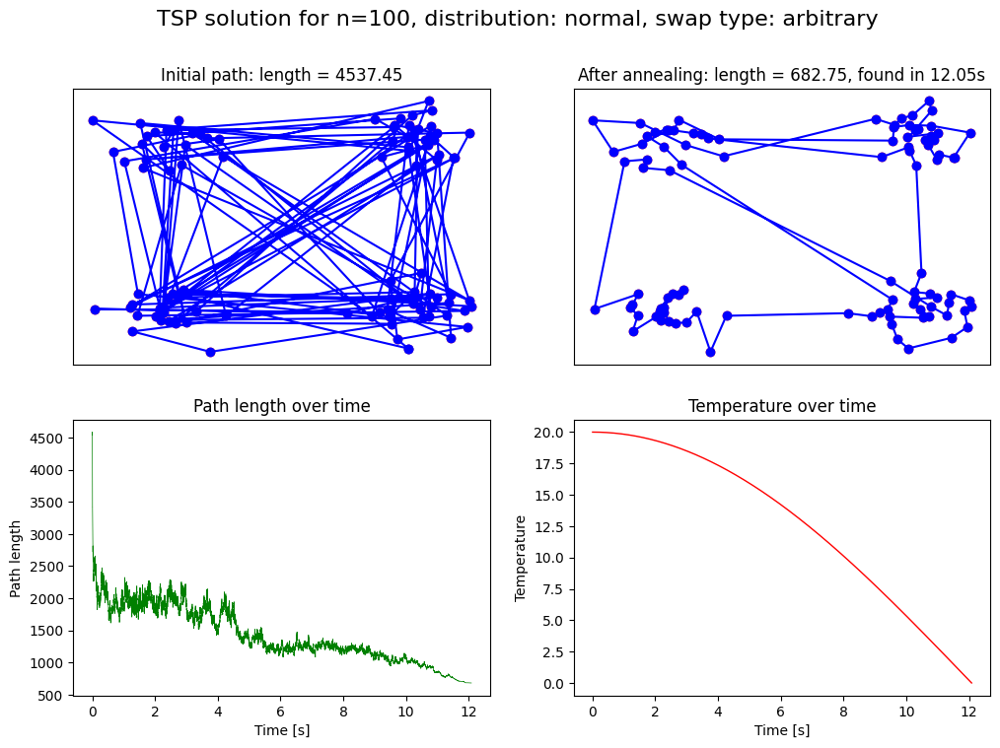

Shortest path comparison for different temperature functions:
T = 0.999T:        603.63, 23.25s
T = T_0(1 - t/12): 718.14, 11.97s
T = T_0cos(0.13t): 682.75, 12.05s

--------------------

Distribution: clusters, temperature function: T = 0.999T
Initial path length: 5542.48
Best path length: 612.61, found in 30.23s
Total elapsed time: 41.45s


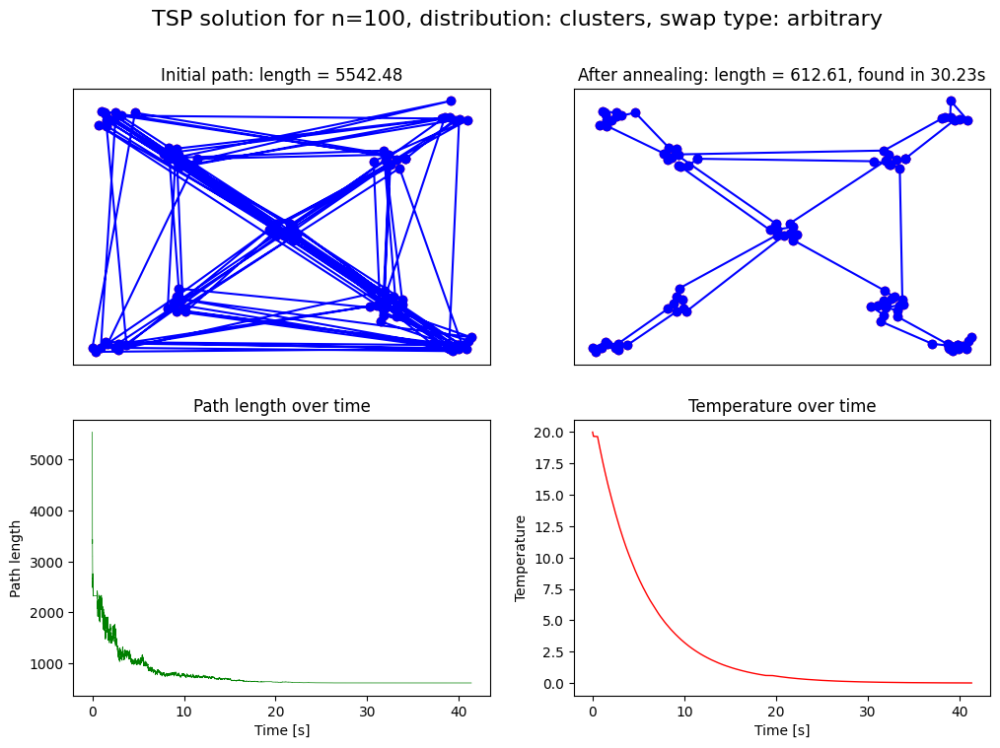

Distribution: clusters, temperature function: T = T_0(1 - t/12)
Initial path length: 5590.72
Best path length: 660.86, found in 11.96s
Total elapsed time: 12.26s


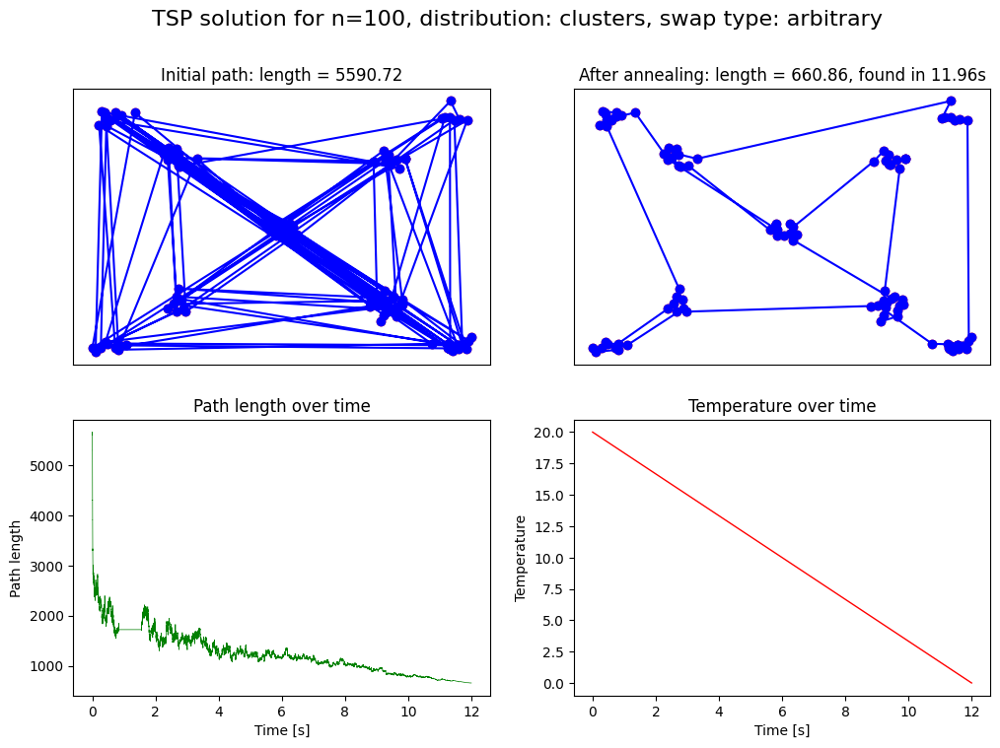

Distribution: clusters, temperature function: T = T_0cos(0.13t)
Initial path length: 5803.97
Best path length: 577.88, found in 12.07s
Total elapsed time: 12.19s


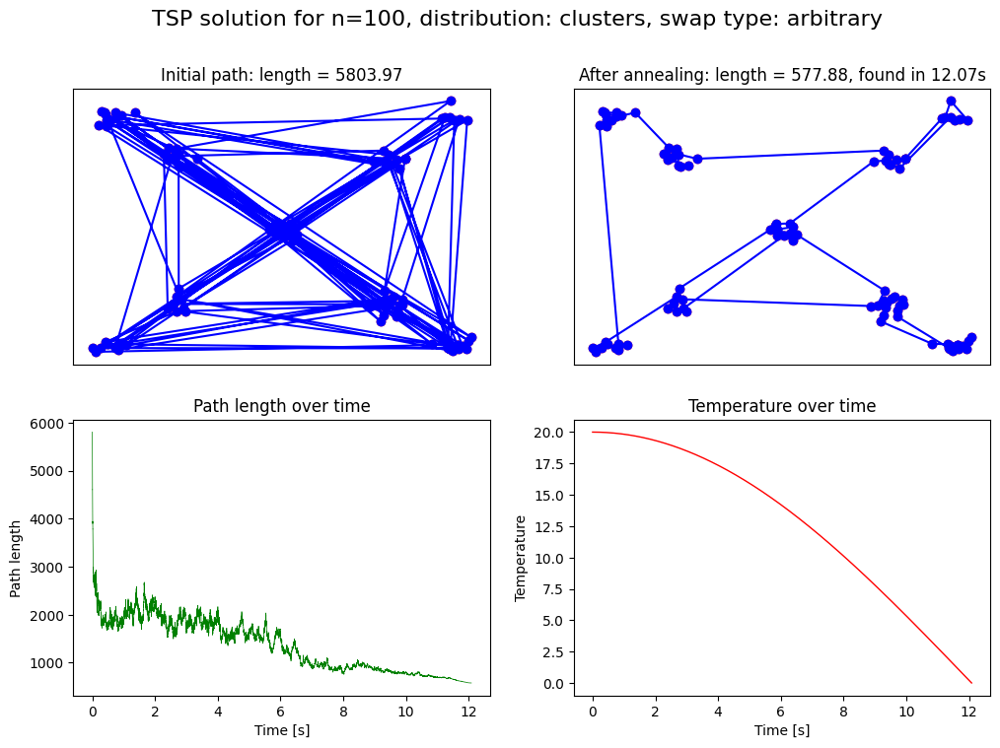

Shortest path comparison for different temperature functions:
T = 0.999T:        612.61, 30.23s
T = T_0(1 - t/12): 660.86, 11.96s
T = T_0cos(0.13t): 577.88, 12.07s



In [33]:
initial_temp = 20
n_values = [20, 50, 100]
distributions = ["uniform", "normal", "clusters"]
temp_functions = {
    "T = 0.999T": lambda x, _: 0.999 * x, 
    "T = T_0(1 - t/12)": lambda _, t: initial_temp * (1 - t / 12),
    "T = T_0cos(0.13t)": lambda _, t: initial_temp * math.cos(t * 0.13),
}

for n in n_values:
    print(f"---------- n = {n} ----------\n")
    for dist in distributions:
        points = generate_points(n, dist)
        results = []

        for temp_fn_name, temp_fn in temp_functions.items():
            start = time.time()
            best_path, best_length, found_time, initial_path, initial_length, lengths, temps, _ =\
                simulated_annealing(points, temperature = initial_temp, temp_function=temp_fn)
            elapsed = time.time() - start

            results.append((temp_fn_name, best_length, found_time))

            print(f"Distribution: {dist}, temperature function: {temp_fn_name}")
            print(f"Initial path length: {initial_length:.2f}")
            print(f"Best path length: {best_length:.2f}, found in {found_time:.2f}s")
            print(f"Total elapsed time: {elapsed:.2f}s")

            plot_results(
                points,
                best_path,
                best_length,
                found_time,
                initial_path,
                initial_length,
                lengths,
                temps,
                n,
                dist,
                "arbitrary"
            )

        print("Shortest path comparison for different temperature functions:") 
        for temp_fn_name, best_length, found_time in results:
            if temp_fn_name == "T = 0.999T":
                print(f"{temp_fn_name}:        {best_length:.2f}, {found_time:.2f}s")
            else:
                print(f"{temp_fn_name}: {best_length:.2f}, {found_time:.2f}s")
        print()
        if dist != "clusters":
            print("--------------------\n")

#### Obserwacje
##### n = 20
- **T = 0.999T**:
  - dużo szybsza niż pozostałe dwie
- **T = T₀(1 - t/12)**:
  - minimalnie szybsza od funkcji cosinusowej
- **T = T₀cos(0.13t)**:
  - najwolniejsza

**Wyniki**:  
Funkcje temperatury znajdowały identyczne (lub bardzo zbliżone) ścieżki, niezależnie od rozkładu punktów.

---

##### n = 50
- **T = 0.999T**:
  - nadal najszybsza, ale różnica w czasie względem pozostałych zmniejszona
  - słabe wyniki jakościowe
- **T = T₀(1 - t/12)**:
  - średnie wyniki i średnia wydajność
- **T = T₀cos(0.13t)**:
  - najlepsze wyniki jakościowe
  - najgorsza wydajność (ale różnice w czasie niewielkie)

**Wyniki**:  
Rezultaty bardziej zróżnicowane niż dla n = 20.

---

##### n = 100
- **T = 0.999T**:
  - zdecydowanie najwolniejsza, wyraźna różnica czasu względem innych funkcji
- **T = T₀(1 - t/12)**:
  - czas działania porównywalny do funkcji cosinusowej
- **T = T₀cos(0.13t)**:
  - czas działania porównywalny do funkcji liniowej

**Wyniki**:  
Przy większej liczbie punktów wyniki były zupełnie inne dla różnych dystrybucji – dla każdej dystrybucji inna funkcja temperatury osiągnęła najlepsze rozwiązanie.

---

#### Wnioski

- Przy małych chmurach punktów (n = 20) funkcja temperatury ma niewielki wpływ na jakość rozwiązania, ale istotnie wpływa na czas działania.
- Dla większych chmur (n = 50, n = 100) funkcje temperatury zaczynają znacząco wpływać na jakość znajdowanych ścieżek.
- Funkcja **T = T₀cos(0.13t)** daje z reguły najlepsze wyniki jakościowe kosztem wydajności.
- Funkcja **T = 0.999T** jest szybka dla małych n, ale skaluje się słabo i daje gorsze wyniki przy większych problemach.
- Dobór funkcji temperatury może wymagać dostosowania do charakterystyki konkretnej instancji problemu (np. dystrybucji punktów).